In [1]:
import requests
import seaborn as sns
import plotly.express as px
import pycountry as pc
import json
import pandas as pd
import matplotlib.pyplot as plt
from bs4 import BeautifulSoup
from pyjstat import pyjstat
import numpy as np
import plotly.graph_objects as go

def get_tsa(country):
    country = country.title()
    url = f"https://travel.state.gov/content/travel/en/international-travel/International-Travel-Country-Information-Pages/{country}.html"

    url_html = requests.get(url).text

    soup = BeautifulSoup(url_html)

    return soup.find_all(class_='tsg-rwd-eab-title-frame')

In [2]:
print(get_tsa('canada'))

[<h3 class="tsg-rwd-eab-title-frame">Worldwide Caution</h3>, <h3 class="tsg-rwd-eab-title-frame">Information for U.S. Citizens in the Middle East</h3>, <h3 class="tsg-rwd-eab-title-frame">Canada - Level 1: Exercise Normal Precautions</h3>]


In [3]:
def get_eurostat_data(article_title, *args):
    '''
    To Do:
        - Write *args
        - Write _url_builder() helper func.
    '''
    
    article_title = article_title.upper()
    url = f'https://ec.europa.eu/eurostat/api/dissemination/statistics/1.0/data/{article_title}?format=JSON&lang=EN'

    output = pyjstat.Dataset.read(url)
    df = output.write('dataframe')

    return df

In [4]:
crime = get_eurostat_data('crim_off_cat')

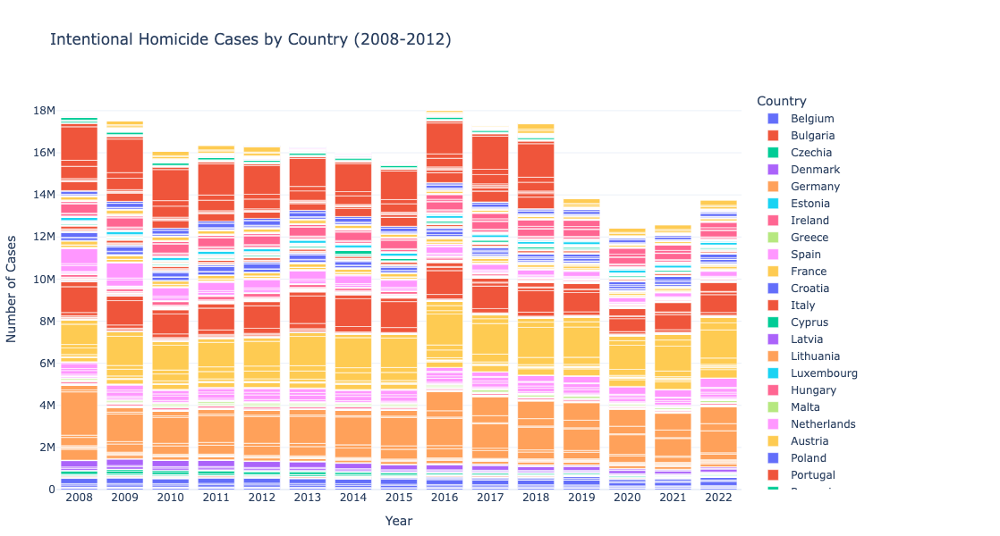

In [5]:
# Lineplot - cases per nation over time
fig = px.bar(crime, x='Time', y='value', color='Geopolitical entity (reporting)',
              title='Intentional Homicide Cases by Country (2008-2012)')
fig.update_layout(
    xaxis_title='Year',
    yaxis_title='Number of Cases',
    legend_title='Country',
    template='plotly_white',
    width=1000,  # Set the width of the plot
    height=600,  # Set the height of the plot
    margin=dict(l=50, r=50, t=100, b=50)
)
fig.show()

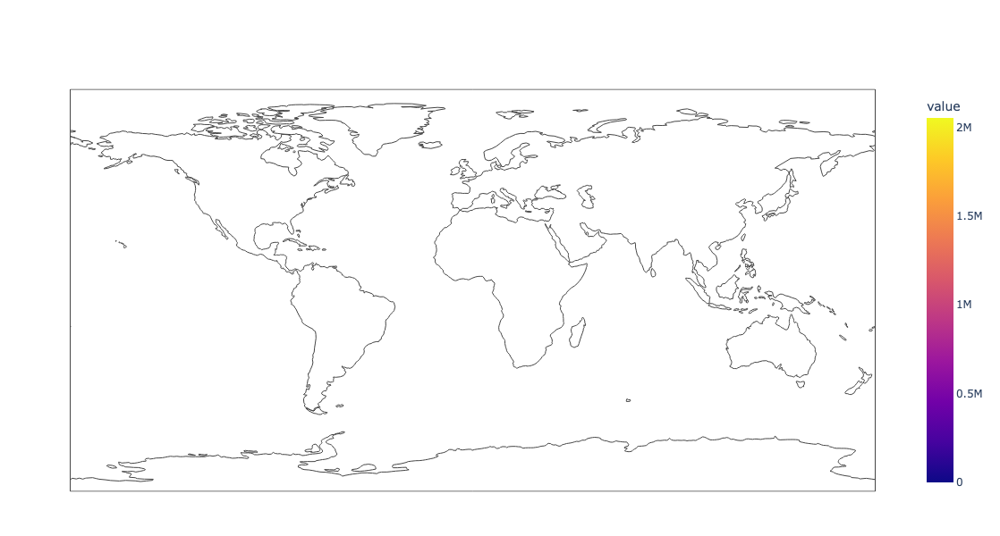

In [6]:
# Lineplot - cases per nation over time
fig = px.choropleth(crime, locations='Geopolitical entity (reporting)', color='value', hover_name='Geopolitical entity (reporting)', color_continuous_scale=px.colors.sequential.Plasma)
fig.update_layout(
    xaxis_title='Year',
    yaxis_title='Number of Cases',
    legend_title='Country',
    template='plotly_white',
    width=1000,  # Set the width of the plot
    height=600,  # Set the height of the plot
    margin=dict(l=50, r=50, t=100, b=50)
)
fig.show()

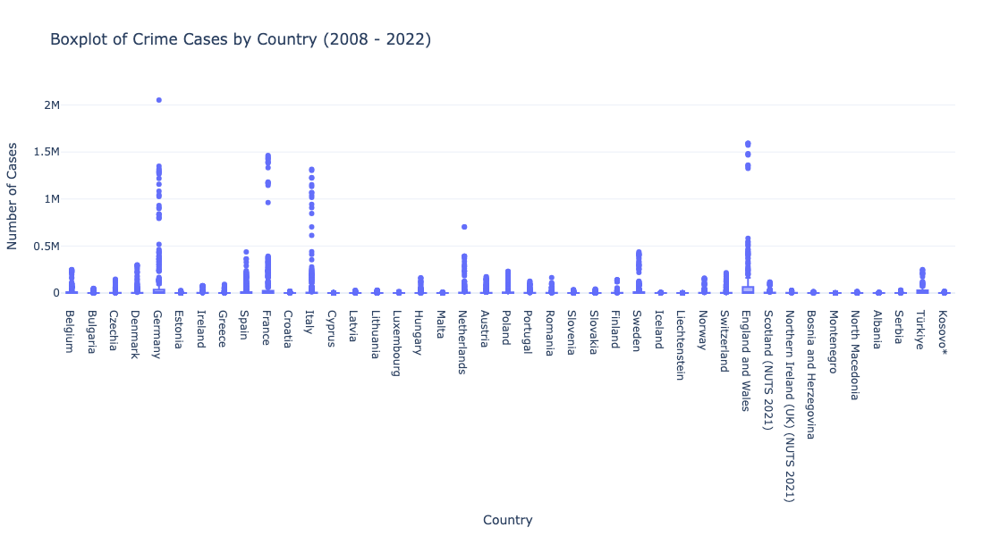

In [7]:
# Create a box plot using Plotly
fig_box = px.box(crime, x='Geopolitical entity (reporting)', y='value',
                 title=f'Boxplot of Crime Cases by Country ({crime['Time'].min()} - {crime['Time'].max()})')

fig_box.update_layout(
    xaxis_title='Country',
    yaxis_title='Number of Cases',
    template='plotly_white',
    width=900,  # Set the width of the plot
    height=600,  # Set the height of the plot
    margin=dict(l=50, r=50, t=100, b=50)  # Add margins to prevent squishing
)

fig_box.show()

In [8]:
crime

,Time frequency,International classification of crime for statistical purposes (ICCS),Unit of measure,Geopolitical entity (reporting),Time,value
0,Annual,Intentional homicide,Number,Belgium,2008,204.00
1,Annual,Intentional homicide,Number,Belgium,2009,189.00
2,Annual,Intentional homicide,Number,Belgium,2010,189.00
3,Annual,Intentional homicide,Number,Belgium,2011,214.00
4,Annual,Intentional homicide,Number,Belgium,2012,206.00
...,...,...,...,...,...,...
25825,Annual,Participation in an organized criminal group,Per hundred thousand inhabitants,Kosovo*,2018,0.11
25826,Annual,Participation in an organized criminal group,Per hundred thousand inhabitants,Kosovo*,2019,0.17
25827,Annual,Participation in an organized criminal group,Per hundred thousand inhabitants,Kosovo*,2020,0.28
25828,Annual,Participation in an organized criminal group,Per hundred thousand inhabitants,Kosovo*,2021,NaN


In [9]:
happiness = get_eurostat_data('ilc_pw08')
happiness = happiness.drop(happiness[happiness.Frequency == 'Unknown'].index)
happiness

,Time frequency,Unit of measure,International Standard Classification of Education (ISCED 2011),Frequency,Sex,Age class,Geopolitical entity (reporting),Time,value
0,Annual,Percentage,All ISCED 2011 levels,Always,Total,From 16 to 24 years,European Union - 27 countries (from 2020),2013,16.2
1,Annual,Percentage,All ISCED 2011 levels,Always,Total,From 16 to 24 years,European Union - 27 countries (from 2020),2018,19.5
2,Annual,Percentage,All ISCED 2011 levels,Always,Total,From 16 to 24 years,European Union - 27 countries (from 2020),2022,19.1
3,Annual,Percentage,All ISCED 2011 levels,Always,Total,From 16 to 24 years,Belgium,2013,16.7
4,Annual,Percentage,All ISCED 2011 levels,Always,Total,From 16 to 24 years,Belgium,2018,18.7
...,...,...,...,...,...,...,...,...,...
69421,Annual,Percentage,Short-cycle tertiary education and Bachelor's ...,Never,Females,75 years or over,Türkiye,2018,NaN
69422,Annual,Percentage,Short-cycle tertiary education and Bachelor's ...,Never,Females,75 years or over,Türkiye,2022,NaN
69423,Annual,Percentage,Short-cycle tertiary education and Bachelor's ...,Never,Females,75 years or over,Kosovo*,2013,NaN
69424,Annual,Percentage,Short-cycle tertiary education and Bachelor's ...,Never,Females,75 years or over,Kosovo*,2018,NaN


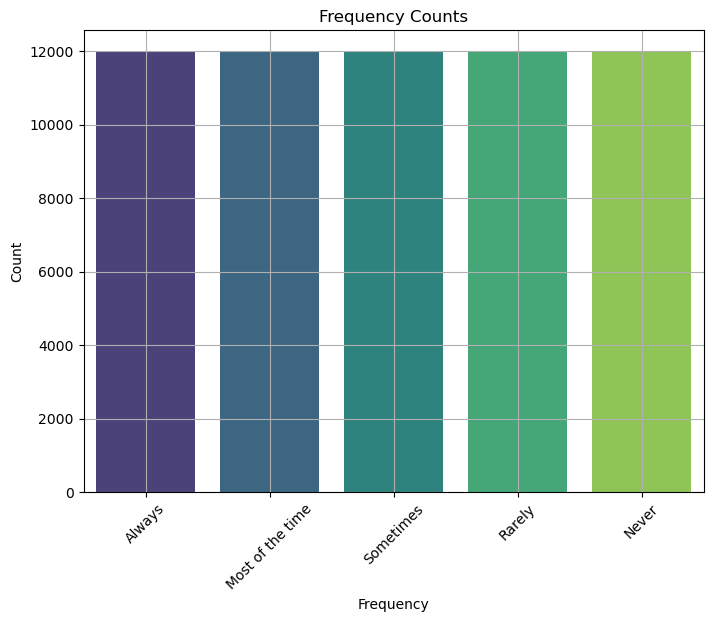

In [10]:
# Plot the frequency column values
plt.figure(figsize=(8, 6))
sns.countplot(x='Frequency', data=happiness, palette='viridis', hue='Frequency')
plt.title('Frequency Counts')
plt.xlabel('Frequency')
plt.ylabel('Count')
plt.xticks(rotation=45)
plt.grid(True)
plt.show()

In [11]:
train_system = get_eurostat_data('ttr00015')
train_system

,Time frequency,Unit of measure,Transport coverage,Geopolitical entity (reporting),Time,value
0,Annual,Millions of passenger-kilometres,Total transport,European Union - 27 countries (from 2020),2012,NaN
1,Annual,Millions of passenger-kilometres,Total transport,European Union - 27 countries (from 2020),2013,NaN
2,Annual,Millions of passenger-kilometres,Total transport,European Union - 27 countries (from 2020),2014,NaN
3,Annual,Millions of passenger-kilometres,Total transport,European Union - 27 countries (from 2020),2015,375713.0
4,Annual,Millions of passenger-kilometres,Total transport,European Union - 27 countries (from 2020),2016,384335.0
...,...,...,...,...,...,...
475,Annual,Millions of passenger-kilometres,Total transport,Türkiye,2019,4912.0
476,Annual,Millions of passenger-kilometres,Total transport,Türkiye,2020,1520.0
477,Annual,Millions of passenger-kilometres,Total transport,Türkiye,2021,2251.0
478,Annual,Millions of passenger-kilometres,Total transport,Türkiye,2022,5922.0


In [12]:
leisure = get_eurostat_data('ilc_scp01')
leisure

,Time frequency,Frequency,International Standard Classification of Education (ISCED 2011),Age class,Sex,Unit of measure,Geopolitical entity (reporting),Time,value
0,Annual,Not in the last 12 months,All ISCED 2011 levels,From 16 to 24 years,Total,Percentage,European Union - 27 countries (from 2020),2006,NaN
1,Annual,Not in the last 12 months,All ISCED 2011 levels,From 16 to 24 years,Total,Percentage,European Union - 27 countries (from 2020),2015,12.4
2,Annual,Not in the last 12 months,All ISCED 2011 levels,From 16 to 24 years,Total,Percentage,European Union - 27 countries (from 2020),2022,NaN
3,Annual,Not in the last 12 months,All ISCED 2011 levels,From 16 to 24 years,Total,Percentage,Belgium,2006,6.4
4,Annual,Not in the last 12 months,All ISCED 2011 levels,From 16 to 24 years,Total,Percentage,Belgium,2015,9.8
...,...,...,...,...,...,...,...,...,...
51835,Annual,At least once,Tertiary education (levels 5-8),75 years or over,Females,Percentage,Serbia,2015,30.6
51836,Annual,At least once,Tertiary education (levels 5-8),75 years or over,Females,Percentage,Serbia,2022,26.0
51837,Annual,At least once,Tertiary education (levels 5-8),75 years or over,Females,Percentage,Türkiye,2006,NaN
51838,Annual,At least once,Tertiary education (levels 5-8),75 years or over,Females,Percentage,Türkiye,2015,NaN


In [13]:
social_exclusion = get_eurostat_data('ilc_peps01n')
social_exclusion

,Time frequency,Unit of measure,Age class,Sex,Geopolitical entity (reporting),Time,value
0,Annual,Thousand persons,Total,Total,"European Union (EU6-1958, EU9-1973, EU10-1981,...",2014,NaN
1,Annual,Thousand persons,Total,Total,"European Union (EU6-1958, EU9-1973, EU10-1981,...",2015,119632.0
2,Annual,Thousand persons,Total,Total,"European Union (EU6-1958, EU9-1973, EU10-1981,...",2016,117794.0
3,Annual,Thousand persons,Total,Total,"European Union (EU6-1958, EU9-1973, EU10-1981,...",2017,112399.0
4,Annual,Thousand persons,Total,Total,"European Union (EU6-1958, EU9-1973, EU10-1981,...",2018,109997.0
...,...,...,...,...,...,...,...
89755,Annual,Percentage,75 years or over,Females,Türkiye,2019,26.2
89756,Annual,Percentage,75 years or over,Females,Türkiye,2020,25.8
89757,Annual,Percentage,75 years or over,Females,Türkiye,2021,20.3
89758,Annual,Percentage,75 years or over,Females,Türkiye,2022,NaN


In [14]:
pop_demo = get_eurostat_data('demo_pjangroup')
pop_demo = pop_demo.drop(pop_demo[pop_demo.value == 0.0].index)
pop_demo = pop_demo.dropna()
pop_demo

,Time frequency,Unit of measure,Sex,Age class,Geopolitical entity (reporting),Time,value
0,Annual,Number,Total,Total,European Union - 27 countries (from 2020),1960,354531754.0
5,Annual,Number,Total,Total,European Union - 27 countries (from 2020),1965,370521157.0
10,Annual,Number,Total,Total,European Union - 27 countries (from 2020),1970,384326562.0
11,Annual,Number,Total,Total,European Union - 27 countries (from 2020),1971,385949080.0
15,Annual,Number,Total,Total,European Union - 27 countries (from 2020),1975,395835667.0
...,...,...,...,...,...,...,...
252656,Annual,Number,Females,Unknown,Georgia,2008,492.0
252657,Annual,Number,Females,Unknown,Georgia,2009,360.0
252658,Annual,Number,Females,Unknown,Georgia,2010,361.0
252659,Annual,Number,Females,Unknown,Georgia,2011,320.0


In [15]:
cost_of_living = get_eurostat_data('ilc_mded04')

In [16]:
cost_of_living.dtypes

Time frequency                                                    object
Type of household                                                 object
Income situation in relation to the risk of poverty threshold     object
Affordability                                                     object
Unit of measure                                                   object
Geopolitical entity (reporting)                                   object
Time                                                              object
value                                                            float64
dtype: object

# FORMAL DATA CLEANING

#### DATASETS
- HAPPINESS
- CRIME
- TRAIN_SYSTEM
- LEISURE
- SOCIAL_EXCLUSION
- POP_DEMO
- COST_OF_LIVING

In [17]:
eu_nations = [
    'austria',
    'belgium',
    'bulgaria',
    'croatia',
    'cyprus',
    'czechia',
    'denmark',
    'estonia',
    'finland',
    'france',
    'germany',
    'greece',
    'hungary',
    'ireland',
    'italy',
    'latvia',
    'lithuania',
    'luxembourg',
    'malta',
    'netherlands',
    'poland',
    'portugal',
    'romania',
    'slovakia',
    'spain',
    'sweden',
    'slovenia'
]

eu_nations = [nation.upper() for nation in eu_nations]

### Happiness Index Cleaning

In [18]:
happiness

,Time frequency,Unit of measure,International Standard Classification of Education (ISCED 2011),Frequency,Sex,Age class,Geopolitical entity (reporting),Time,value
0,Annual,Percentage,All ISCED 2011 levels,Always,Total,From 16 to 24 years,European Union - 27 countries (from 2020),2013,16.2
1,Annual,Percentage,All ISCED 2011 levels,Always,Total,From 16 to 24 years,European Union - 27 countries (from 2020),2018,19.5
2,Annual,Percentage,All ISCED 2011 levels,Always,Total,From 16 to 24 years,European Union - 27 countries (from 2020),2022,19.1
3,Annual,Percentage,All ISCED 2011 levels,Always,Total,From 16 to 24 years,Belgium,2013,16.7
4,Annual,Percentage,All ISCED 2011 levels,Always,Total,From 16 to 24 years,Belgium,2018,18.7
...,...,...,...,...,...,...,...,...,...
69421,Annual,Percentage,Short-cycle tertiary education and Bachelor's ...,Never,Females,75 years or over,Türkiye,2018,NaN
69422,Annual,Percentage,Short-cycle tertiary education and Bachelor's ...,Never,Females,75 years or over,Türkiye,2022,NaN
69423,Annual,Percentage,Short-cycle tertiary education and Bachelor's ...,Never,Females,75 years or over,Kosovo*,2013,NaN
69424,Annual,Percentage,Short-cycle tertiary education and Bachelor's ...,Never,Females,75 years or over,Kosovo*,2018,NaN


In [19]:
happiness['Geopolitical entity (reporting)'].unique()

array(['European Union - 27 countries (from 2020)', 'Belgium', 'Bulgaria',
       'Czechia', 'Denmark', 'Germany', 'Estonia', 'Ireland', 'Greece',
       'Spain', 'France', 'Croatia', 'Italy', 'Cyprus', 'Latvia',
       'Lithuania', 'Luxembourg', 'Hungary', 'Malta', 'Netherlands',
       'Austria', 'Poland', 'Portugal', 'Romania', 'Slovenia', 'Slovakia',
       'Finland', 'Sweden', 'Iceland', 'Norway', 'Switzerland',
       'United Kingdom', 'Montenegro', 'North Macedonia', 'Albania',
       'Serbia', 'Türkiye', 'Kosovo*'], dtype=object)

In [20]:
happiness.dropna(inplace=True)

happiness['Geopolitical entity (reporting)'] = happiness['Geopolitical entity (reporting)'].str.upper()
happiness = happiness[happiness['Geopolitical entity (reporting)'].isin(eu_nations)]

In [21]:
happiness['Time'] = happiness['Time'].astype(int)

/var/folders/v4/340w5vk97xqcnghtc6q03v_m0000gn/T/ipykernel_65297/4247802222.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [22]:
from collections import Counter
count = Counter(happiness['International Standard Classification of Education (ISCED 2011)'])
count

Counter({'All ISCED 2011 levels': 8400,
         'Upper secondary and post-secondary non-tertiary education (levels 3 and 4)': 8380,
         'Less than primary, primary and lower secondary education (levels 0-2)': 8275,
         'Tertiary education (levels 5-8)': 8090,
         "Short-cycle tertiary education and Bachelor's or equivalent level (levels 5 and 6)": 510})

In [23]:
happiness_ohe_cols = ['International Standard Classification of Education (ISCED 2011)', 'Frequency', 'Sex', 'Age class', 'Geopolitical entity (reporting)']
happiness_ohe = pd.get_dummies(happiness, columns=happiness_ohe_cols, dtype=int)

In [24]:
happiness_ohe.dtypes

Time frequency                                                                                                                                         object
Unit of measure                                                                                                                                        object
Time                                                                                                                                                    int64
value                                                                                                                                                 float64
International Standard Classification of Education (ISCED 2011)_All ISCED 2011 levels                                                                   int64
International Standard Classification of Education (ISCED 2011)_Less than primary, primary and lower secondary education (levels 0-2)                   int64
International Standard Classification of Education (

In [25]:
happiness_ohe

,Time frequency,Unit of measure,Time,value,International Standard Classification of Education (ISCED 2011)_All ISCED 2011 levels,"International Standard Classification of Education (ISCED 2011)_Less than primary, primary and lower secondary education (levels 0-2)",International Standard Classification of Education (ISCED 2011)_Short-cycle tertiary education and Bachelor's or equivalent level (levels 5 and 6),International Standard Classification of Education (ISCED 2011)_Tertiary education (levels 5-8),International Standard Classification of Education (ISCED 2011)_Upper secondary and post-secondary non-tertiary education (levels 3 and 4),Frequency_Always,...,Geopolitical entity (reporting)_LUXEMBOURG,Geopolitical entity (reporting)_MALTA,Geopolitical entity (reporting)_NETHERLANDS,Geopolitical entity (reporting)_POLAND,Geopolitical entity (reporting)_PORTUGAL,Geopolitical entity (reporting)_ROMANIA,Geopolitical entity (reporting)_SLOVAKIA,Geopolitical entity (reporting)_SLOVENIA,Geopolitical entity (reporting)_SPAIN,Geopolitical entity (reporting)_SWEDEN
3,Annual,Percentage,2013,16.7,1,0,0,0,0,1,...,0,0,0,0,0,0,0,0,0,0
4,Annual,Percentage,2018,18.7,1,0,0,0,0,1,...,0,0,0,0,0,0,0,0,0,0
5,Annual,Percentage,2022,19.6,1,0,0,0,0,1,...,0,0,0,0,0,0,0,0,0,0
6,Annual,Percentage,2013,10.1,1,0,0,0,0,1,...,0,0,0,0,0,0,0,0,0,0
7,Annual,Percentage,2018,13.6,1,0,0,0,0,1,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
69279,Annual,Percentage,2013,2.8,0,0,1,0,0,0,...,0,0,0,0,0,0,0,0,0,1
69333,Annual,Percentage,2013,0.0,0,0,1,0,0,0,...,0,0,0,0,0,0,0,0,0,0
69348,Annual,Percentage,2013,7.5,0,0,1,0,0,0,...,0,0,0,0,0,0,0,0,0,0
69363,Annual,Percentage,2013,4.0,0,0,1,0,0,0,...,0,0,0,0,0,0,0,0,0,0


### Crime Cleaning

In [26]:
crime

,Time frequency,International classification of crime for statistical purposes (ICCS),Unit of measure,Geopolitical entity (reporting),Time,value
0,Annual,Intentional homicide,Number,Belgium,2008,204.00
1,Annual,Intentional homicide,Number,Belgium,2009,189.00
2,Annual,Intentional homicide,Number,Belgium,2010,189.00
3,Annual,Intentional homicide,Number,Belgium,2011,214.00
4,Annual,Intentional homicide,Number,Belgium,2012,206.00
...,...,...,...,...,...,...
25825,Annual,Participation in an organized criminal group,Per hundred thousand inhabitants,Kosovo*,2018,0.11
25826,Annual,Participation in an organized criminal group,Per hundred thousand inhabitants,Kosovo*,2019,0.17
25827,Annual,Participation in an organized criminal group,Per hundred thousand inhabitants,Kosovo*,2020,0.28
25828,Annual,Participation in an organized criminal group,Per hundred thousand inhabitants,Kosovo*,2021,NaN


In [27]:
crime.dropna(inplace=True)

In [28]:
crime.dtypes

Time frequency                                                            object
International classification of crime for statistical purposes (ICCS)     object
Unit of measure                                                           object
Geopolitical entity (reporting)                                           object
Time                                                                      object
value                                                                    float64
dtype: object

In [29]:
crime['Time'] = crime['Time'].astype(int)

In [30]:
crime['Geopolitical entity (reporting)'].unique()
nat_count = Counter(crime['Geopolitical entity (reporting)'])
nat_count

Counter({'Austria': 500,
         'Finland': 500,
         'Czechia': 498,
         'Spain': 498,
         'Greece': 496,
         'Croatia': 496,
         'Germany': 494,
         'Bulgaria': 492,
         'Belgium': 490,
         'Lithuania': 490,
         'Romania': 490,
         'Slovenia': 490,
         'Malta': 486,
         'Serbia': 474,
         'Switzerland': 470,
         'Slovakia': 468,
         'France': 464,
         'Cyprus': 460,
         'Poland': 460,
         'Latvia': 456,
         'Sweden': 456,
         'Portugal': 454,
         'Albania': 453,
         'Estonia': 450,
         'Denmark': 442,
         'Montenegro': 440,
         'Ireland': 430,
         'Luxembourg': 422,
         'Italy': 414,
         'Hungary': 414,
         'Netherlands': 414,
         'Norway': 396,
         'Liechtenstein': 380,
         'Iceland': 370,
         'Kosovo*': 353,
         'Scotland (NUTS 2021)': 286,
         'Northern Ireland (UK) (NUTS 2021)': 282,
         'North Macedoni

In [31]:
crime['Geopolitical entity (reporting)'] = crime['Geopolitical entity (reporting)'].str.upper()
crime = crime[crime['Geopolitical entity (reporting)'].isin(eu_nations)]

In [32]:
crime_ohe_cols = ['International classification of crime for statistical purposes (ICCS)', 'Geopolitical entity (reporting)']
crime_ohe = pd.get_dummies(crime, columns=crime_ohe_cols, dtype=int)

In [33]:
crime = crime.drop(crime[crime['Unit of measure'] == 'Number'].index)

In [34]:
crime.dtypes

Time frequency                                                            object
International classification of crime for statistical purposes (ICCS)     object
Unit of measure                                                           object
Geopolitical entity (reporting)                                           object
Time                                                                       int64
value                                                                    float64
dtype: object

### Train System cleaning

In [35]:
train_system

,Time frequency,Unit of measure,Transport coverage,Geopolitical entity (reporting),Time,value
0,Annual,Millions of passenger-kilometres,Total transport,European Union - 27 countries (from 2020),2012,NaN
1,Annual,Millions of passenger-kilometres,Total transport,European Union - 27 countries (from 2020),2013,NaN
2,Annual,Millions of passenger-kilometres,Total transport,European Union - 27 countries (from 2020),2014,NaN
3,Annual,Millions of passenger-kilometres,Total transport,European Union - 27 countries (from 2020),2015,375713.0
4,Annual,Millions of passenger-kilometres,Total transport,European Union - 27 countries (from 2020),2016,384335.0
...,...,...,...,...,...,...
475,Annual,Millions of passenger-kilometres,Total transport,Türkiye,2019,4912.0
476,Annual,Millions of passenger-kilometres,Total transport,Türkiye,2020,1520.0
477,Annual,Millions of passenger-kilometres,Total transport,Türkiye,2021,2251.0
478,Annual,Millions of passenger-kilometres,Total transport,Türkiye,2022,5922.0


In [36]:
train_system['Geopolitical entity (reporting)'].unique()

array(['European Union - 27 countries (from 2020)',
       'Euro area – 20 countries (from 2023)',
       'Euro area - 19 countries  (2015-2022)', 'Belgium', 'Bulgaria',
       'Czechia', 'Denmark', 'Germany', 'Estonia', 'Ireland', 'Greece',
       'Spain', 'France', 'Croatia', 'Italy', 'Cyprus', 'Latvia',
       'Lithuania', 'Luxembourg', 'Hungary', 'Malta', 'Netherlands',
       'Austria', 'Poland', 'Portugal', 'Romania', 'Slovenia', 'Slovakia',
       'Finland', 'Sweden', 'Iceland', 'Liechtenstein', 'Norway',
       'Switzerland', 'United Kingdom', 'Montenegro', 'North Macedonia',
       'Albania', 'Serbia', 'Türkiye'], dtype=object)

In [37]:
train_system.dtypes

Time frequency                      object
Unit of measure                     object
Transport coverage                  object
Geopolitical entity (reporting)     object
Time                                object
value                              float64
dtype: object

In [38]:
train_system['Time'] = train_system['Time'].astype(int)

In [39]:
train_system.dropna()

,Time frequency,Unit of measure,Transport coverage,Geopolitical entity (reporting),Time,value
3,Annual,Millions of passenger-kilometres,Total transport,European Union - 27 countries (from 2020),2015,375713.0
4,Annual,Millions of passenger-kilometres,Total transport,European Union - 27 countries (from 2020),2016,384335.0
5,Annual,Millions of passenger-kilometres,Total transport,European Union - 27 countries (from 2020),2017,394142.0
6,Annual,Millions of passenger-kilometres,Total transport,European Union - 27 countries (from 2020),2018,400427.0
7,Annual,Millions of passenger-kilometres,Total transport,European Union - 27 countries (from 2020),2019,413923.0
...,...,...,...,...,...,...
475,Annual,Millions of passenger-kilometres,Total transport,Türkiye,2019,4912.0
476,Annual,Millions of passenger-kilometres,Total transport,Türkiye,2020,1520.0
477,Annual,Millions of passenger-kilometres,Total transport,Türkiye,2021,2251.0
478,Annual,Millions of passenger-kilometres,Total transport,Türkiye,2022,5922.0


In [40]:
train_system['Geopolitical entity (reporting)'] = train_system['Geopolitical entity (reporting)'].str.upper()
train_system = train_system[train_system['Geopolitical entity (reporting)'].isin(eu_nations)]

In [41]:
trains_ohe_cols = ['Geopolitical entity (reporting)']
train_system_ohe = pd.get_dummies(train_system, columns=trains_ohe_cols, dtype=int)
train_system_ohe

,Time frequency,Unit of measure,Transport coverage,Time,value,Geopolitical entity (reporting)_AUSTRIA,Geopolitical entity (reporting)_BELGIUM,Geopolitical entity (reporting)_BULGARIA,Geopolitical entity (reporting)_CROATIA,Geopolitical entity (reporting)_CYPRUS,...,Geopolitical entity (reporting)_LUXEMBOURG,Geopolitical entity (reporting)_MALTA,Geopolitical entity (reporting)_NETHERLANDS,Geopolitical entity (reporting)_POLAND,Geopolitical entity (reporting)_PORTUGAL,Geopolitical entity (reporting)_ROMANIA,Geopolitical entity (reporting)_SLOVAKIA,Geopolitical entity (reporting)_SLOVENIA,Geopolitical entity (reporting)_SPAIN,Geopolitical entity (reporting)_SWEDEN
36,Annual,Millions of passenger-kilometres,Total transport,2012,NaN,0,1,0,0,0,...,0,0,0,0,0,0,0,0,0,0
37,Annual,Millions of passenger-kilometres,Total transport,2013,NaN,0,1,0,0,0,...,0,0,0,0,0,0,0,0,0,0
38,Annual,Millions of passenger-kilometres,Total transport,2014,NaN,0,1,0,0,0,...,0,0,0,0,0,0,0,0,0,0
39,Annual,Millions of passenger-kilometres,Total transport,2015,NaN,0,1,0,0,0,...,0,0,0,0,0,0,0,0,0,0
40,Annual,Millions of passenger-kilometres,Total transport,2016,NaN,0,1,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
355,Annual,Millions of passenger-kilometres,Total transport,2019,14617.0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,1
356,Annual,Millions of passenger-kilometres,Total transport,2020,8129.0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,1
357,Annual,Millions of passenger-kilometres,Total transport,2021,8027.0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,1
358,Annual,Millions of passenger-kilometres,Total transport,2022,12879.0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,1


In [42]:
from sklearn.preprocessing import MinMaxScaler
scaler = MinMaxScaler()
crime['norm_val'] = scaler.fit_transform(crime[['value']])
crime

,Time frequency,International classification of crime for statistical purposes (ICCS),Unit of measure,Geopolitical entity (reporting),Time,value,norm_val
615,Annual,Intentional homicide,Per hundred thousand inhabitants,BELGIUM,2008,1.91,0.000350
616,Annual,Intentional homicide,Per hundred thousand inhabitants,BELGIUM,2009,1.76,0.000323
617,Annual,Intentional homicide,Per hundred thousand inhabitants,BELGIUM,2010,1.74,0.000319
618,Annual,Intentional homicide,Per hundred thousand inhabitants,BELGIUM,2011,1.95,0.000358
619,Annual,Intentional homicide,Per hundred thousand inhabitants,BELGIUM,2012,1.86,0.000341
...,...,...,...,...,...,...,...
25600,Annual,Participation in an organized criminal group,Per hundred thousand inhabitants,FINLAND,2018,0.02,0.000004
25601,Annual,Participation in an organized criminal group,Per hundred thousand inhabitants,FINLAND,2019,0.04,0.000007
25602,Annual,Participation in an organized criminal group,Per hundred thousand inhabitants,FINLAND,2020,0.05,0.000009
25603,Annual,Participation in an organized criminal group,Per hundred thousand inhabitants,FINLAND,2021,0.05,0.000009


In [43]:
crime['International classification of crime for statistical purposes (ICCS)'].unique()

array(['Intentional homicide', 'Attempted intentional homicide',
       'Serious assault', 'Kidnapping', 'Sexual violence', 'Rape',
       'Sexual assault', 'Sexual exploitation', 'Child pornography',
       'Robbery', 'Burglary', 'Burglary of private residential premises',
       'Theft', 'Theft of a motorized vehicle or parts thereof',
       'Unlawful acts involving controlled drugs or precursors', 'Fraud',
       'Corruption', 'Bribery', 'Money laundering',
       'Acts against computer systems',
       'Participation in an organized criminal group'], dtype=object)

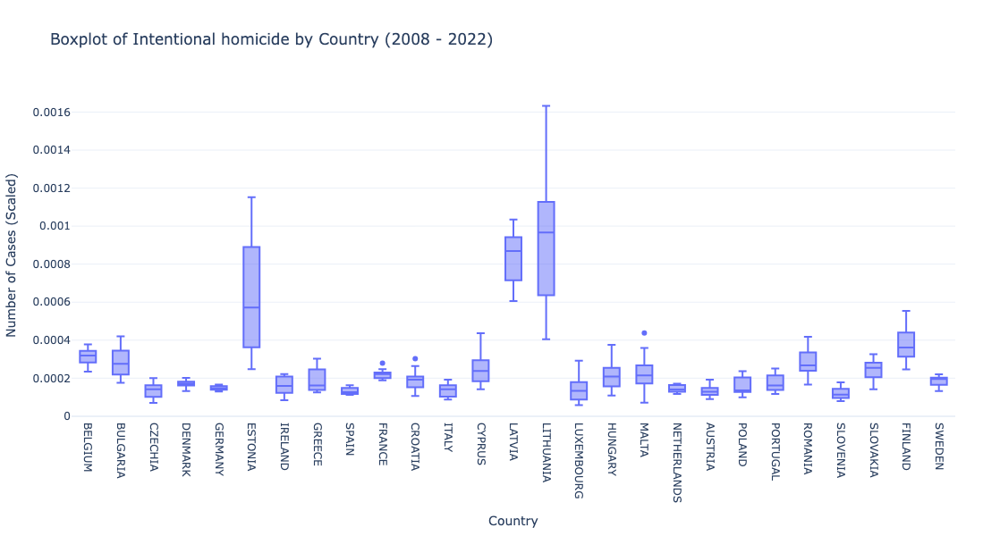

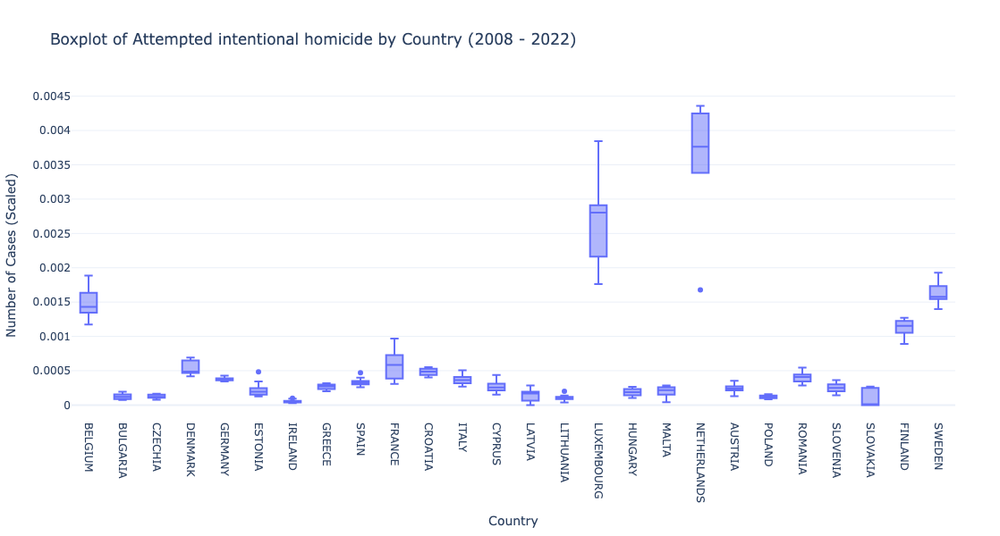

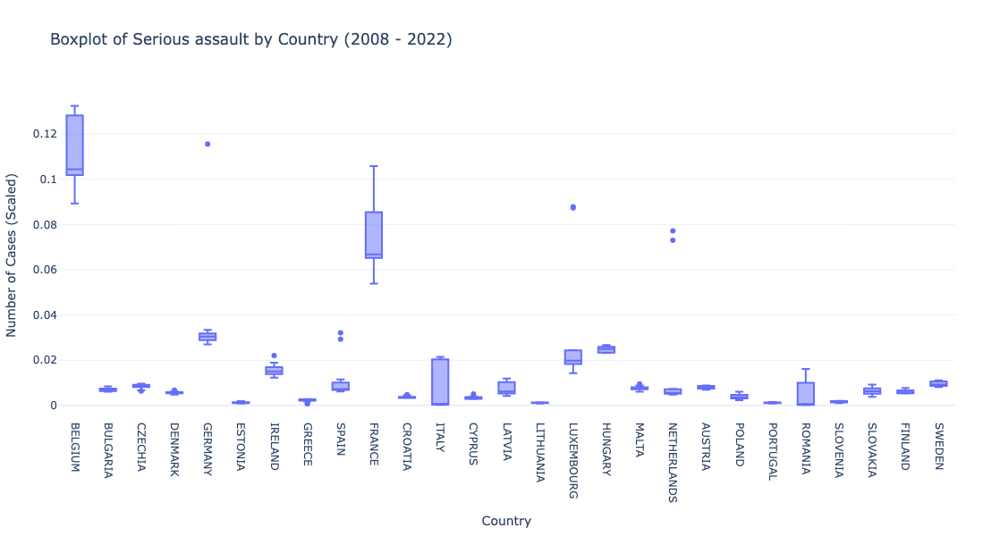

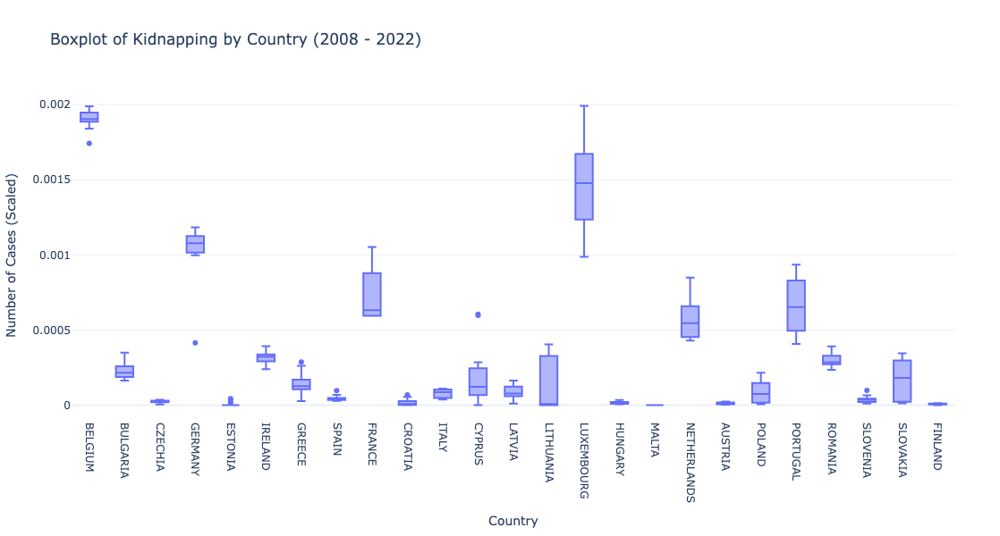

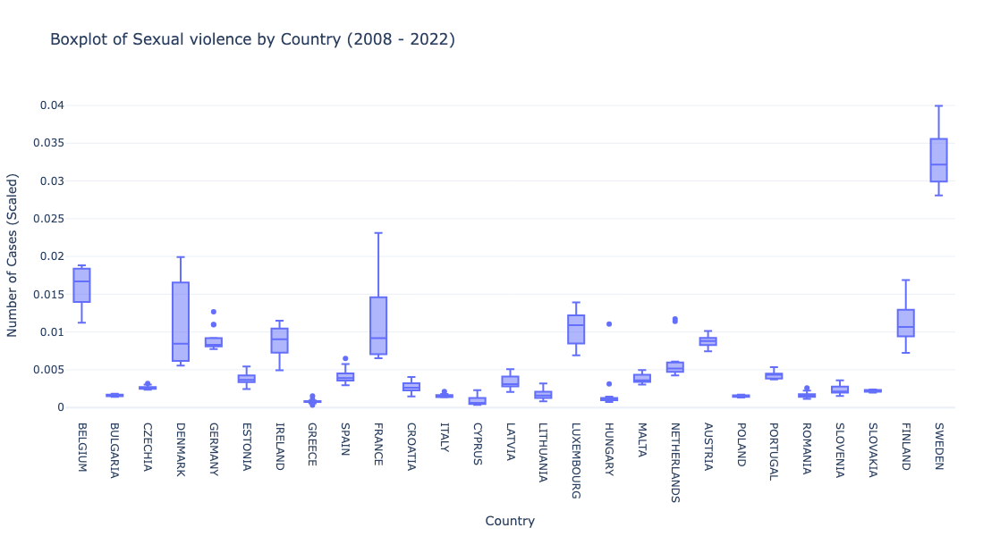

...

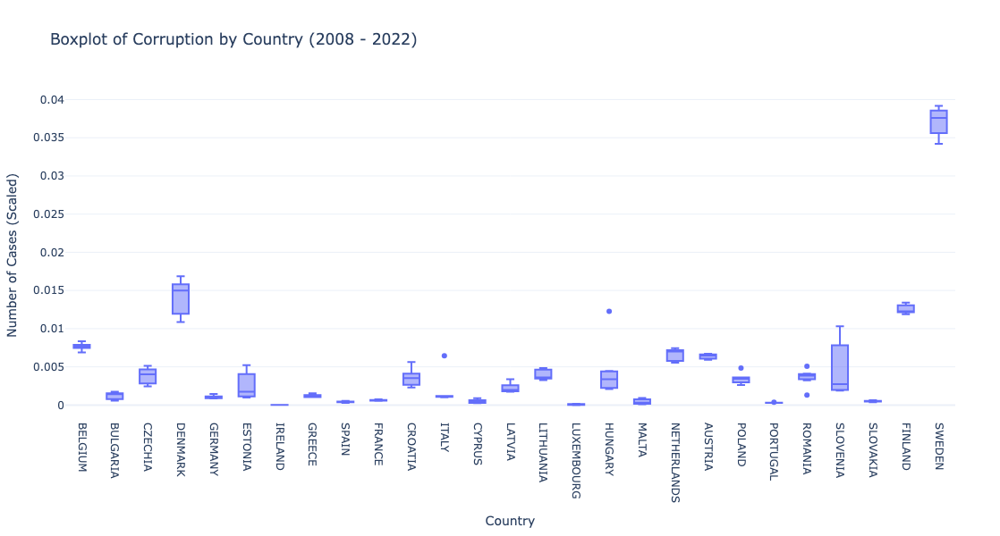

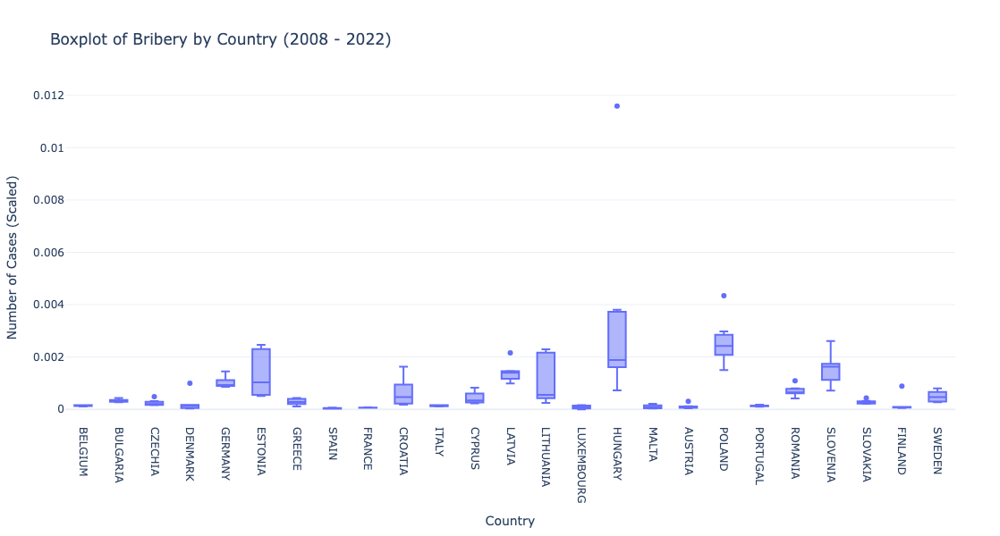

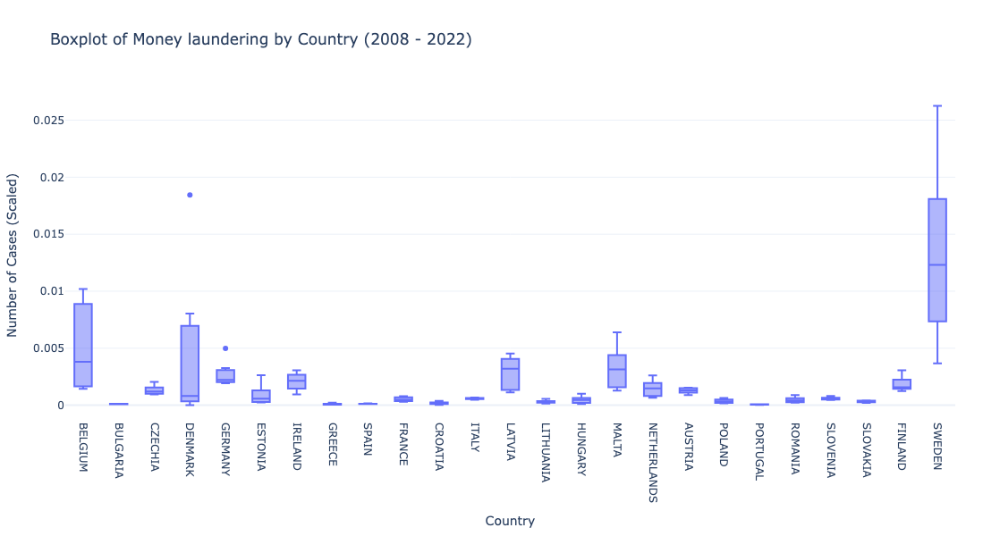

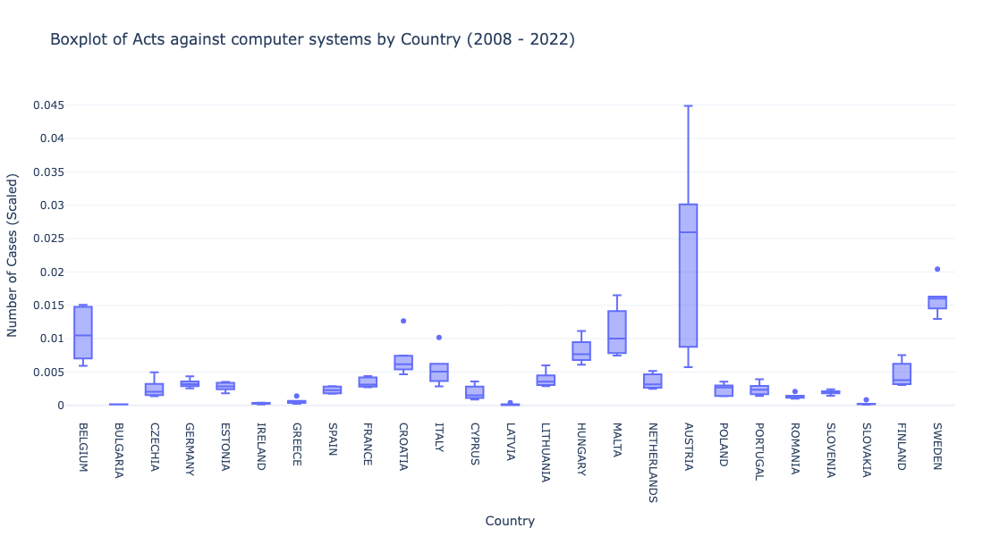

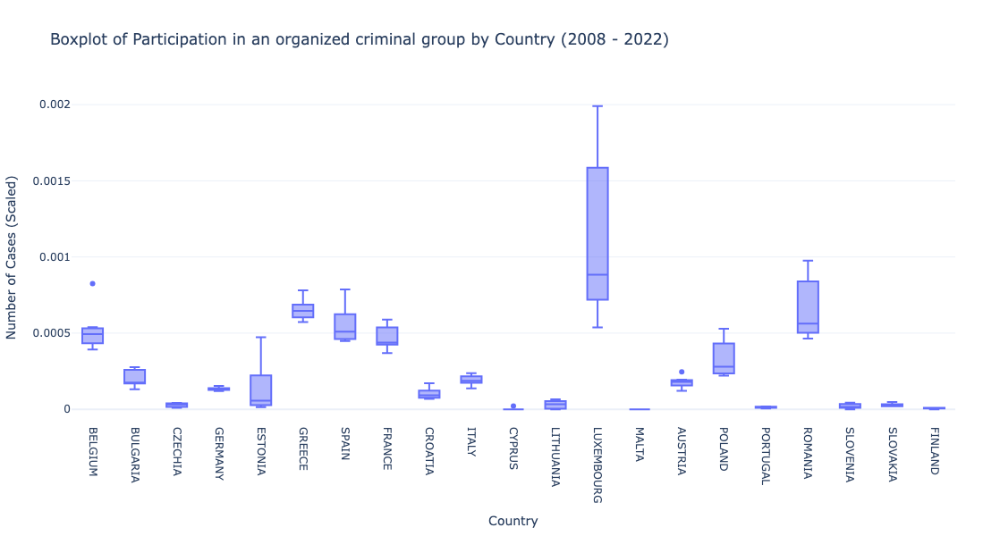

In [44]:
# Unique crime types
crime_types = crime['International classification of crime for statistical purposes (ICCS)'].unique()

# Iterate over each crime type and create a box plot
for crime_type in crime_types:
    crime_data = crime[crime['International classification of crime for statistical purposes (ICCS)'] == crime_type]
    fig_box = px.box(crime_data, x='Geopolitical entity (reporting)', y='norm_val',
                     title=f'Boxplot of {crime_type} by Country ({crime["Time"].min()} - {crime["Time"].max()})')

    fig_box.update_layout(
        xaxis_title='Country',
        yaxis_title='Number of Cases (Scaled)',
        template='plotly_white',
        width=900,  # Set the width of the plot
        height=600,  # Set the height of the plot
        margin=dict(l=50, r=50, t=100, b=50)  # Add margins to prevent squishing
    )

    fig_box.update_xaxes(tickangle=90)

    # Show the figure
    fig_box.show()

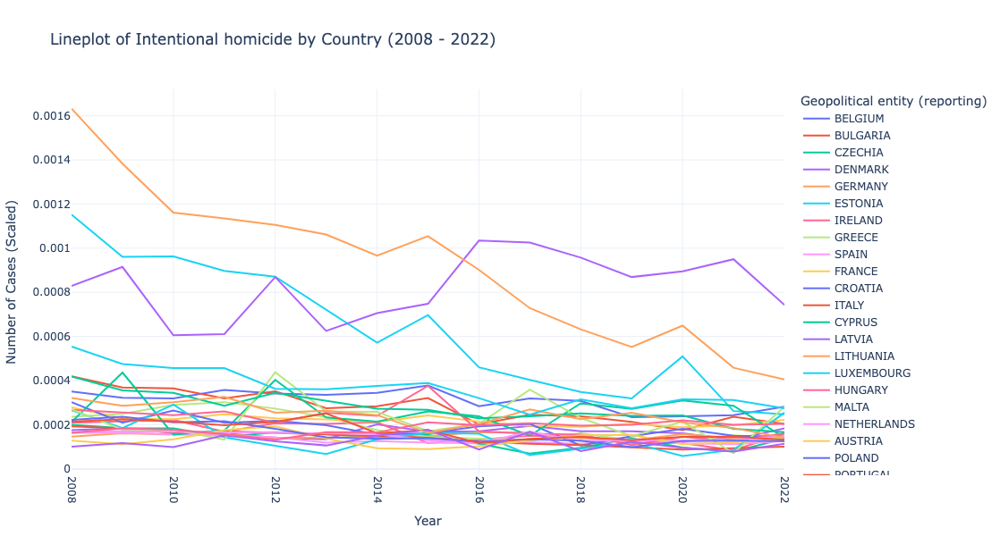

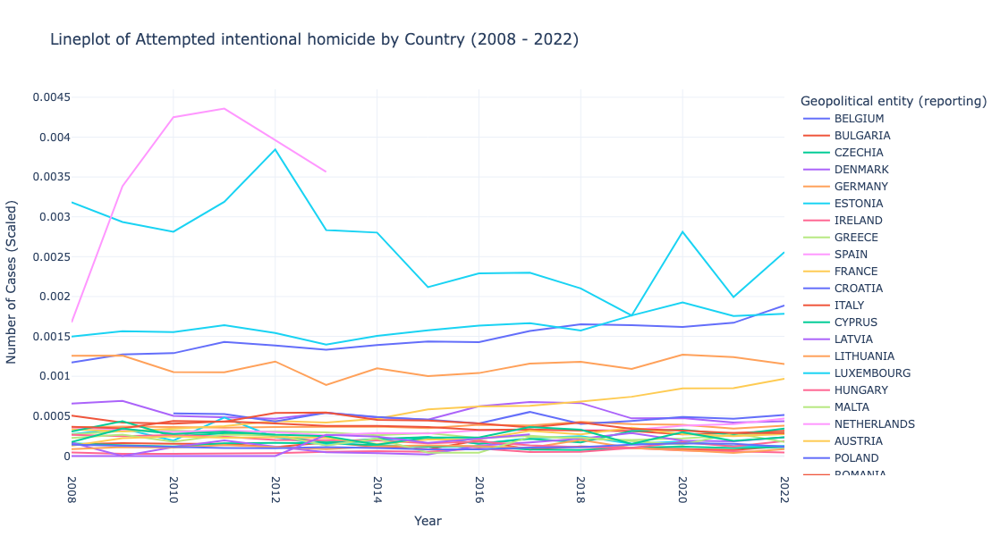

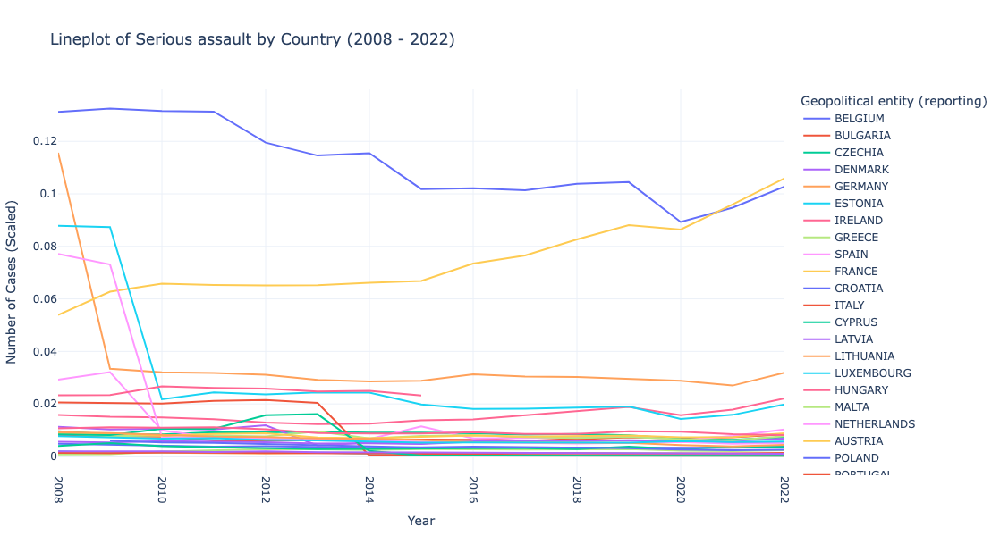

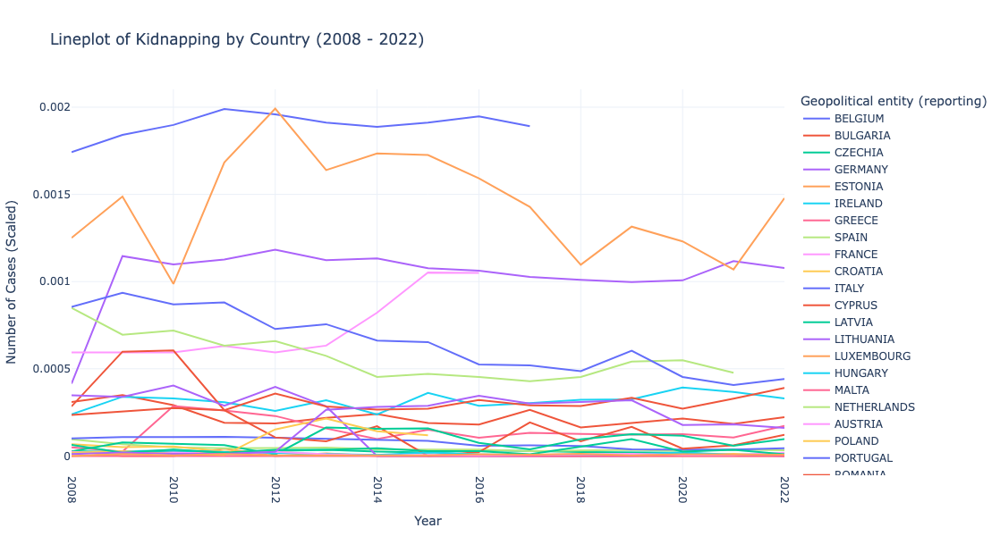

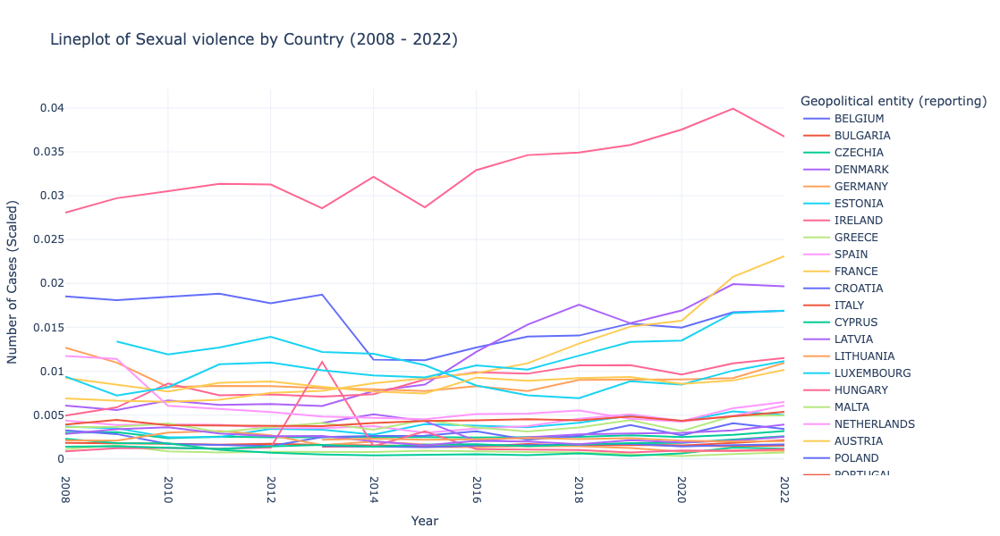

...

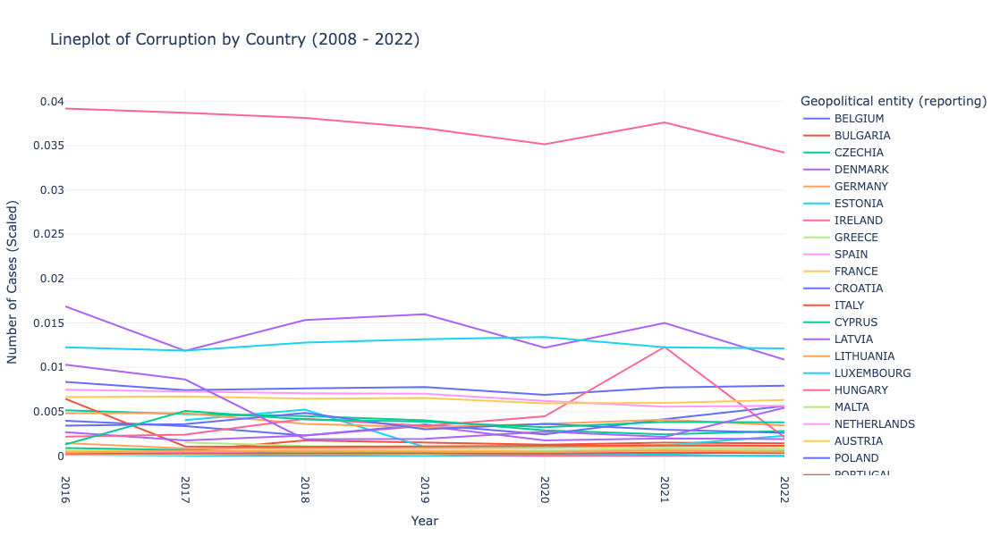

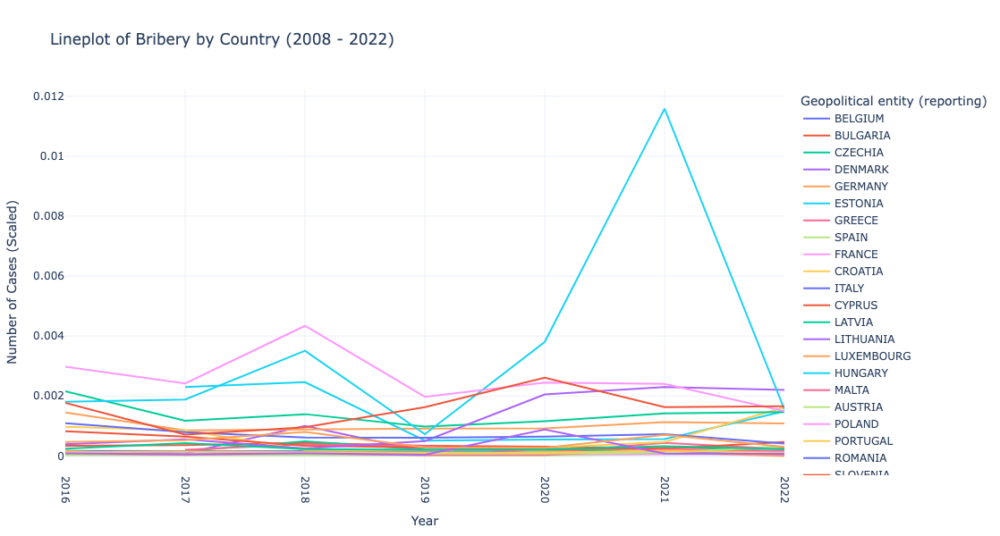

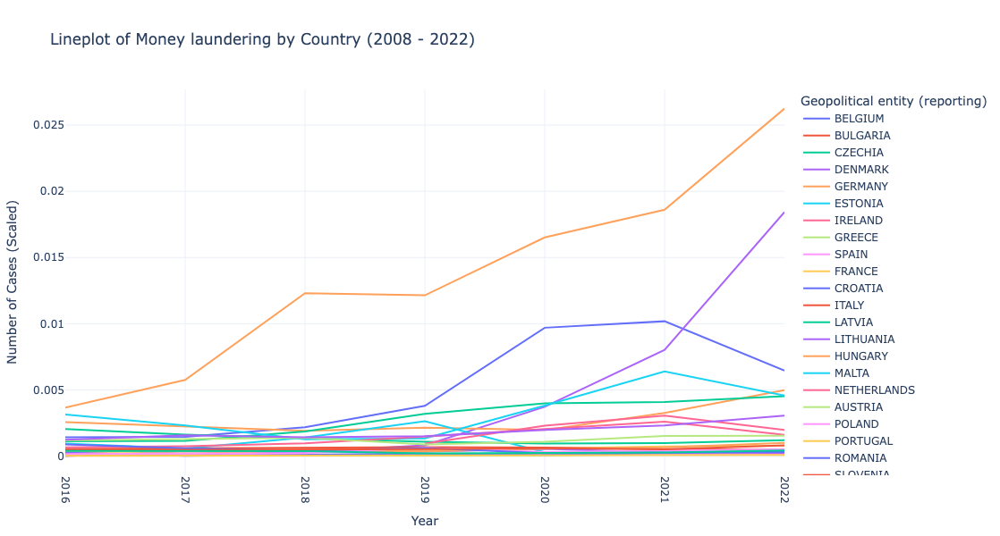

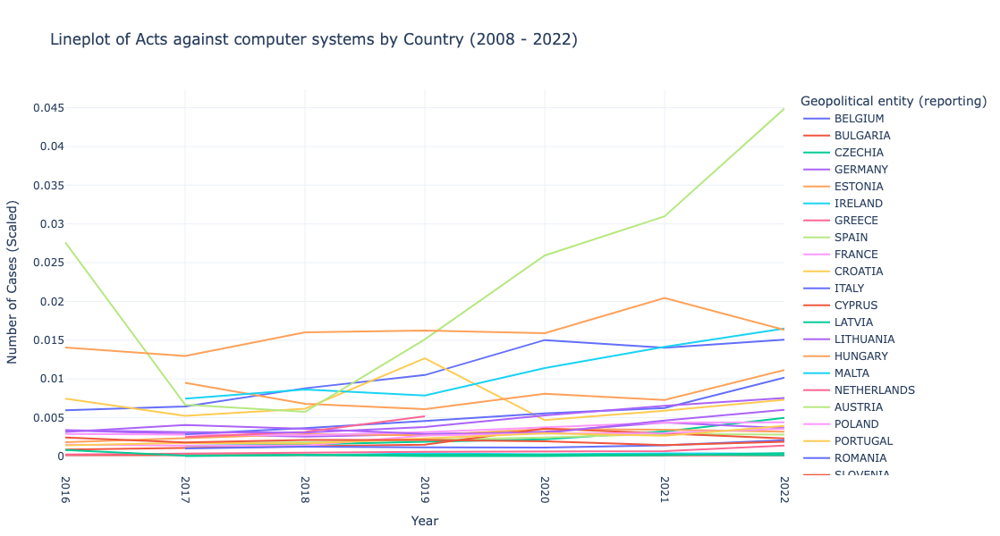

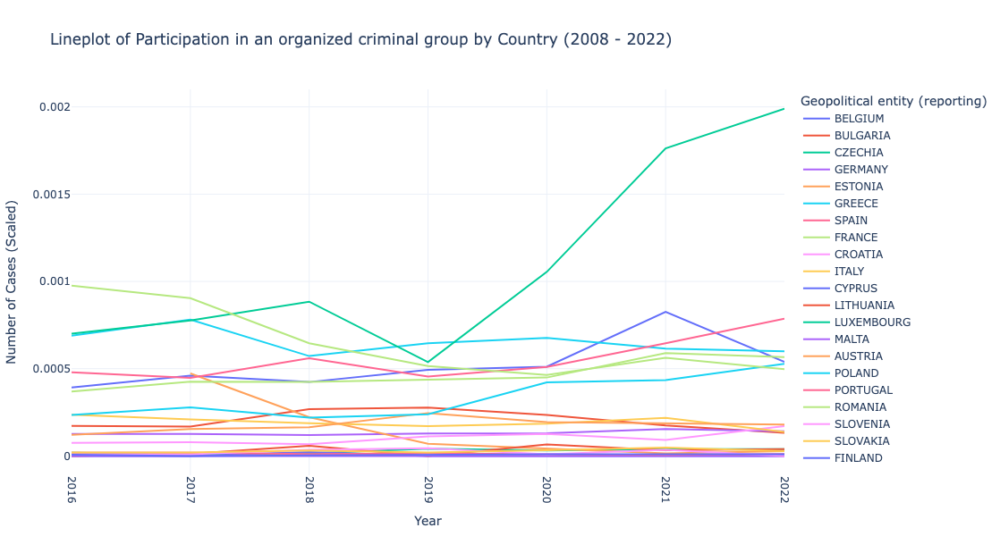

In [45]:
# Unique crime types
crime_types = crime['International classification of crime for statistical purposes (ICCS)'].unique()

# Iterate over each crime type and create a line plot
for crime_type in crime_types:
    crime_data = crime[crime['International classification of crime for statistical purposes (ICCS)'] == crime_type]
    fig_box = px.line(crime_data, x='Time', y='norm_val',
                     title=f'Lineplot of {crime_type} by Country ({crime["Time"].min()} - {crime["Time"].max()})', 
                      color='Geopolitical entity (reporting)')

    fig_box.update_layout(
        xaxis_title='Year',
        yaxis_title='Number of Cases (Scaled)',
        template='plotly_white',
        width=900,  # Set the width of the plot
        height=600,  # Set the height of the plot
        margin=dict(l=50, r=50, t=100, b=50)  # Add margins to prevent squishing
    )

    fig_box.update_xaxes(tickangle=90)

    # Show the figure
    fig_box.show()

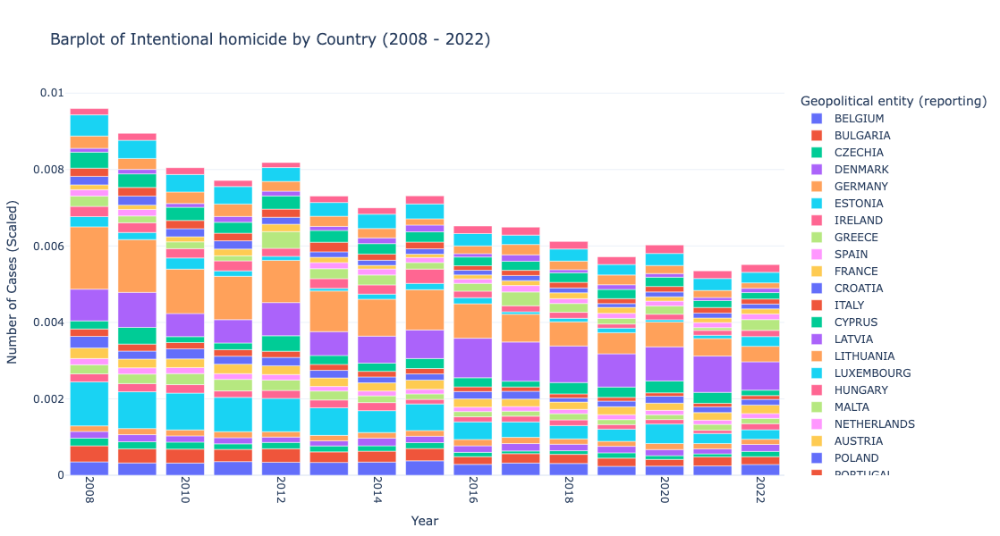

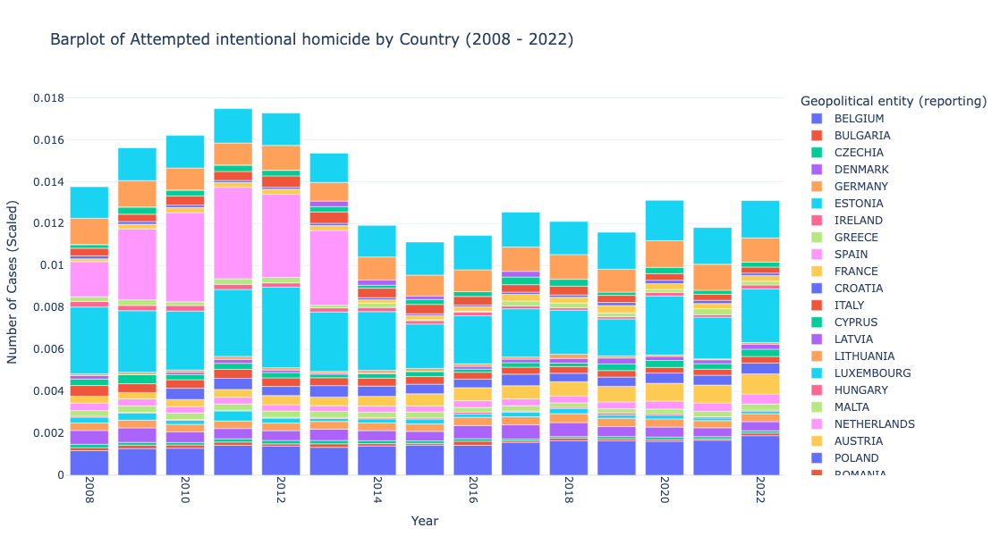

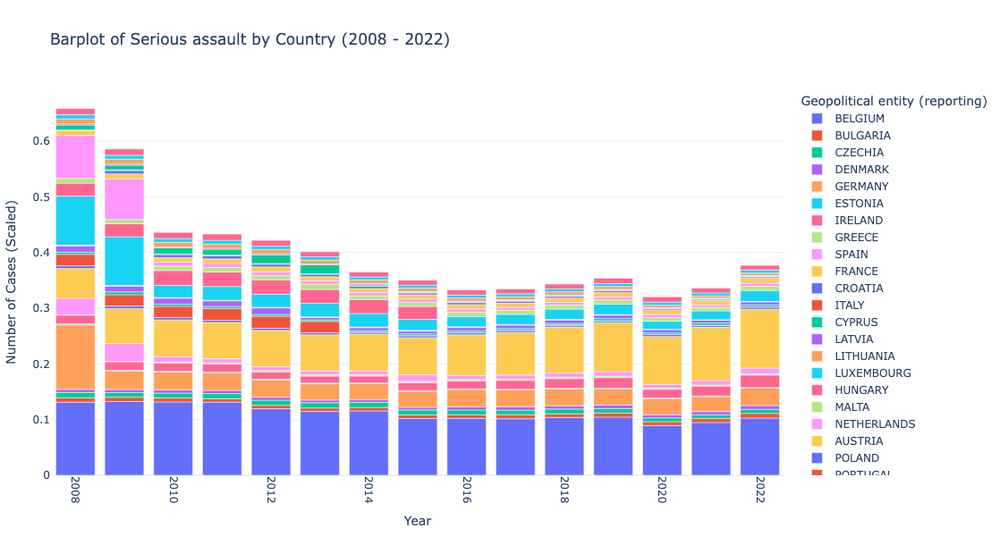

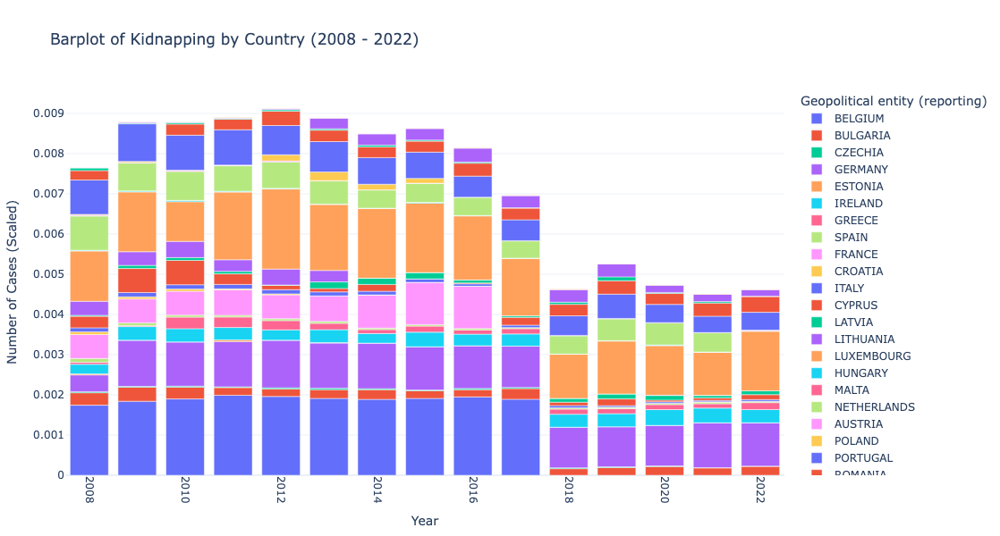

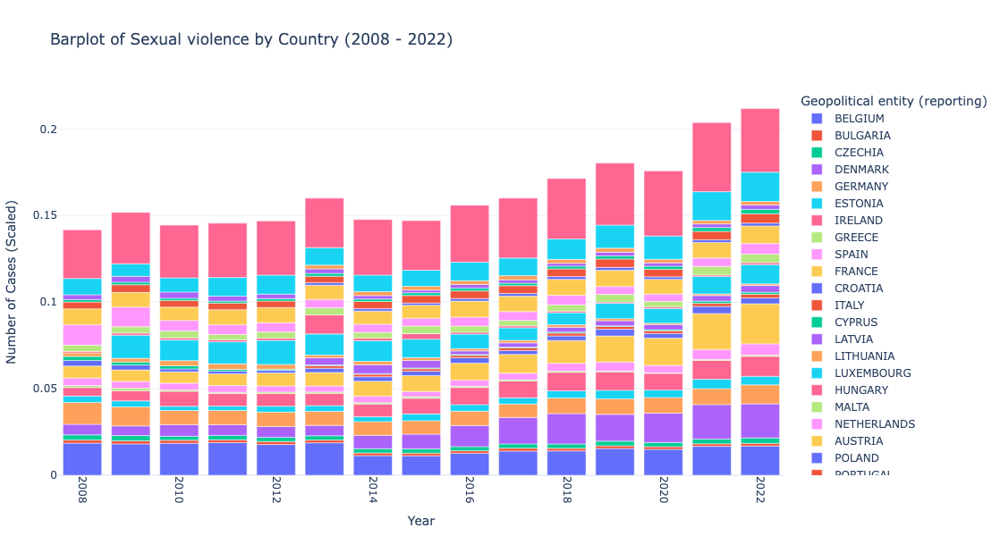

...

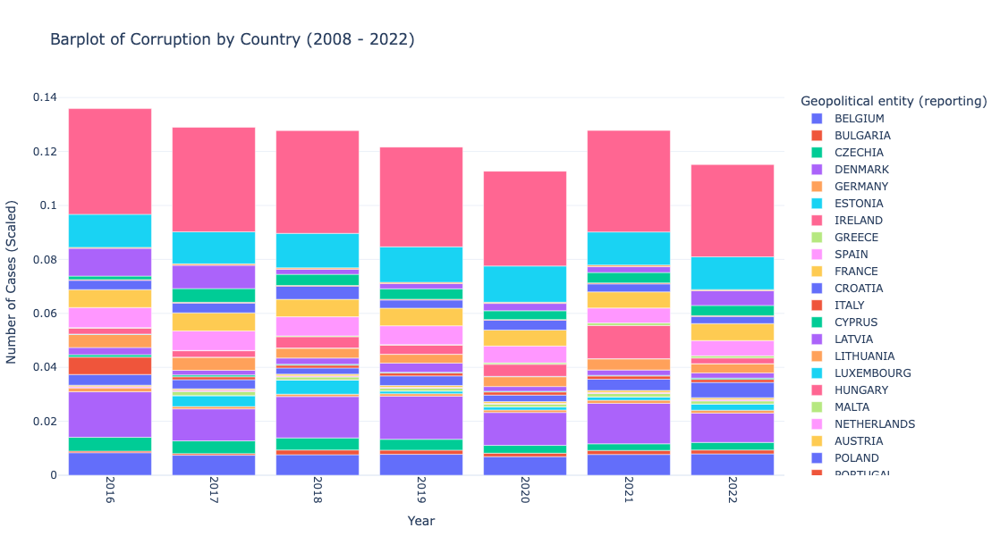

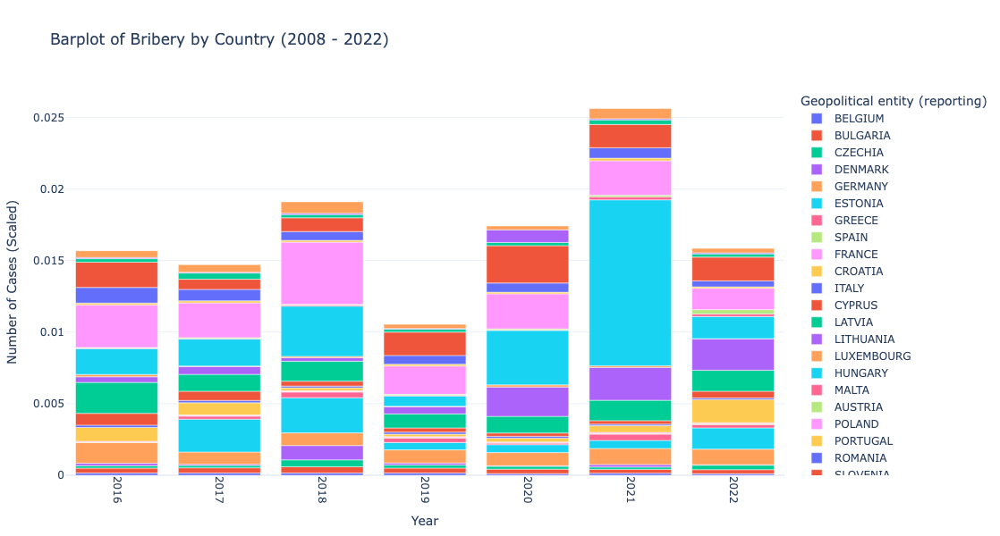

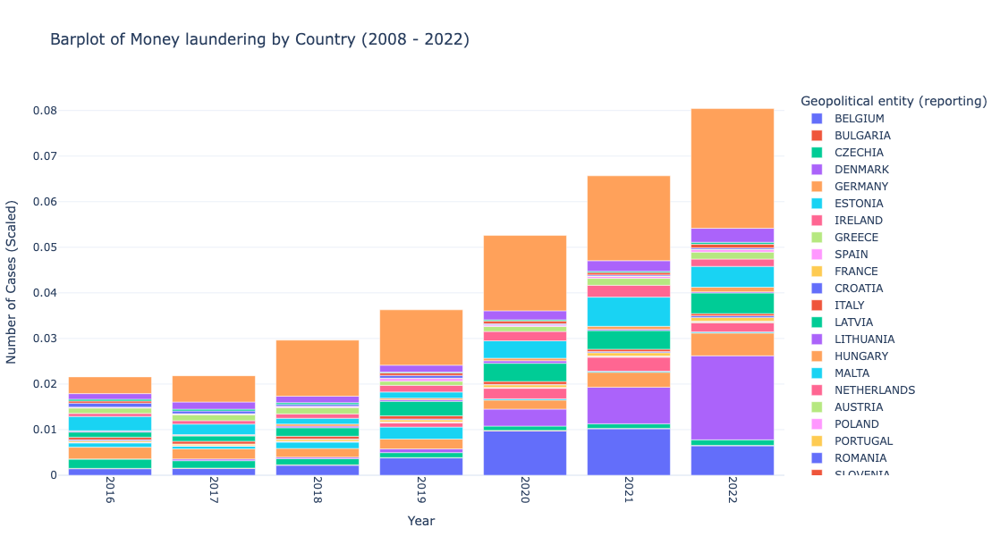

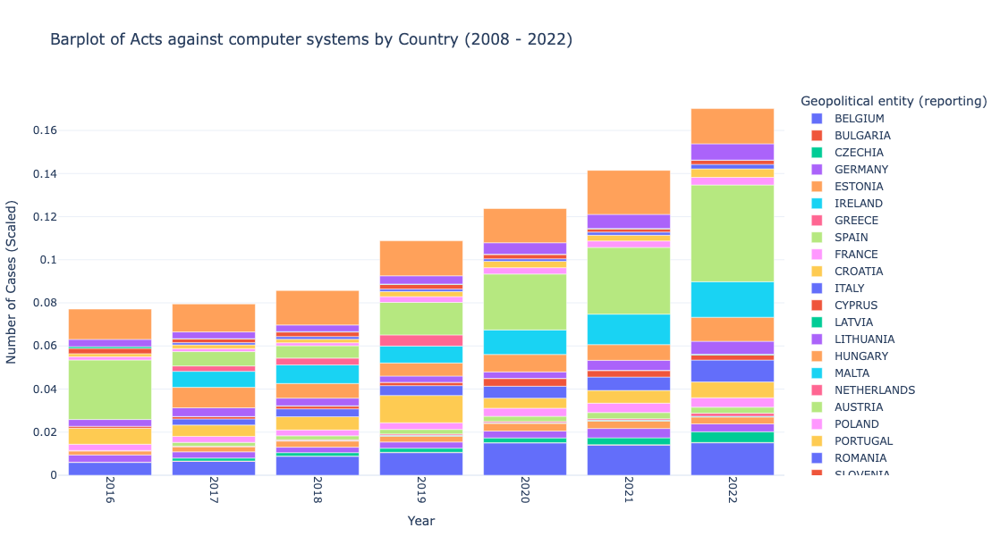

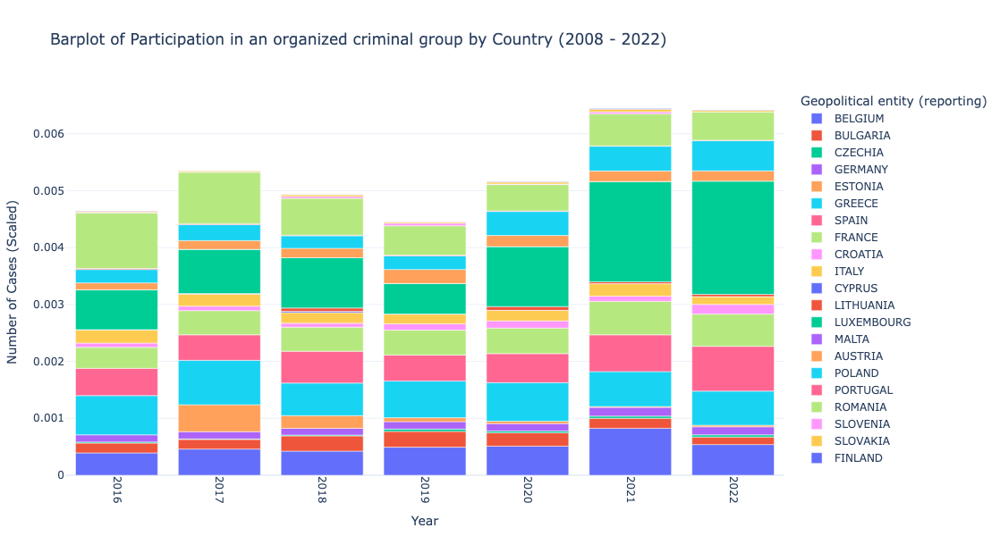

In [46]:
# Unique crime types
crime_types = crime['International classification of crime for statistical purposes (ICCS)'].unique()

# Iterate over each crime type and create a line plot
for crime_type in crime_types:
    crime_data = crime[crime['International classification of crime for statistical purposes (ICCS)'] == crime_type]
    fig_box = px.bar(crime_data, x='Time', y='norm_val',
                     title=f'Barplot of {crime_type} by Country ({crime["Time"].min()} - {crime["Time"].max()})', 
                      color='Geopolitical entity (reporting)')

    fig_box.update_layout(
        xaxis_title='Year',
        yaxis_title='Number of Cases (Scaled)',
        template='plotly_white',
        width=900,  # Set the width of the plot
        height=600,  # Set the height of the plot
        margin=dict(l=50, r=50, t=100, b=50)  # Add margins to prevent squishing
    )

    fig_box.update_xaxes(tickangle=90)

    # Show the figure
    fig_box.show()

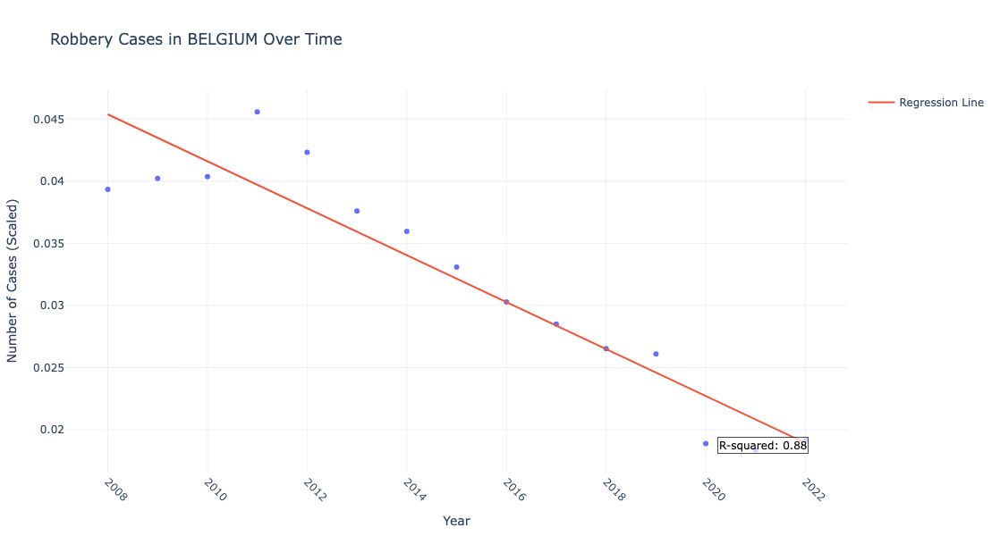

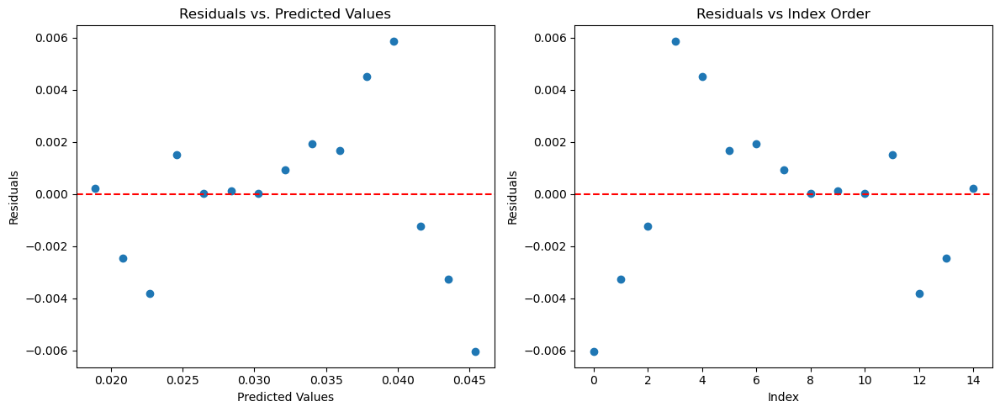

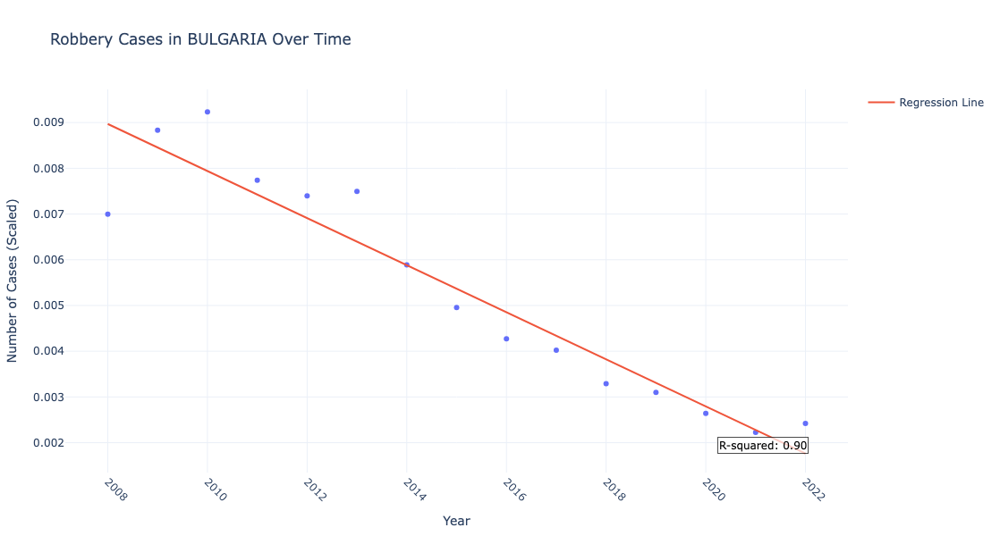

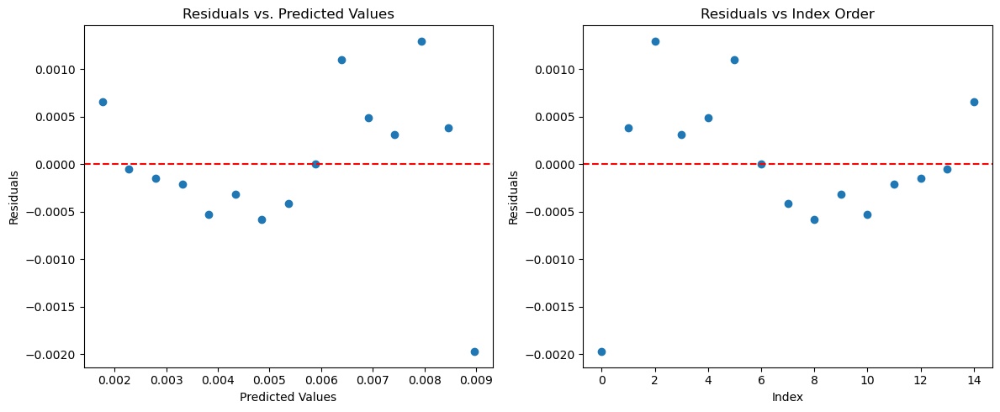

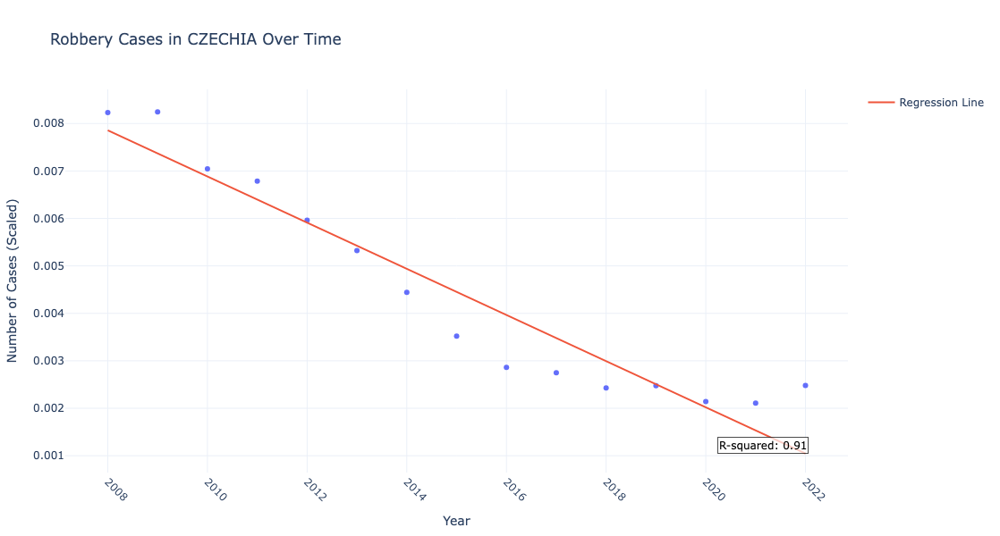

...

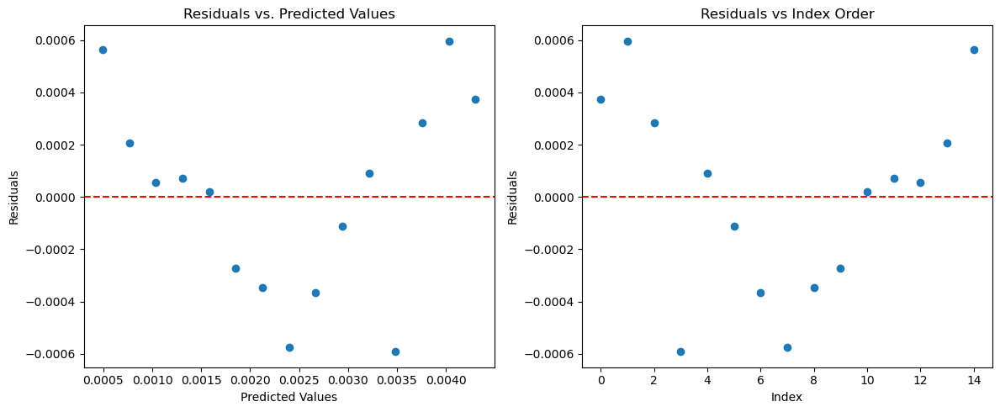

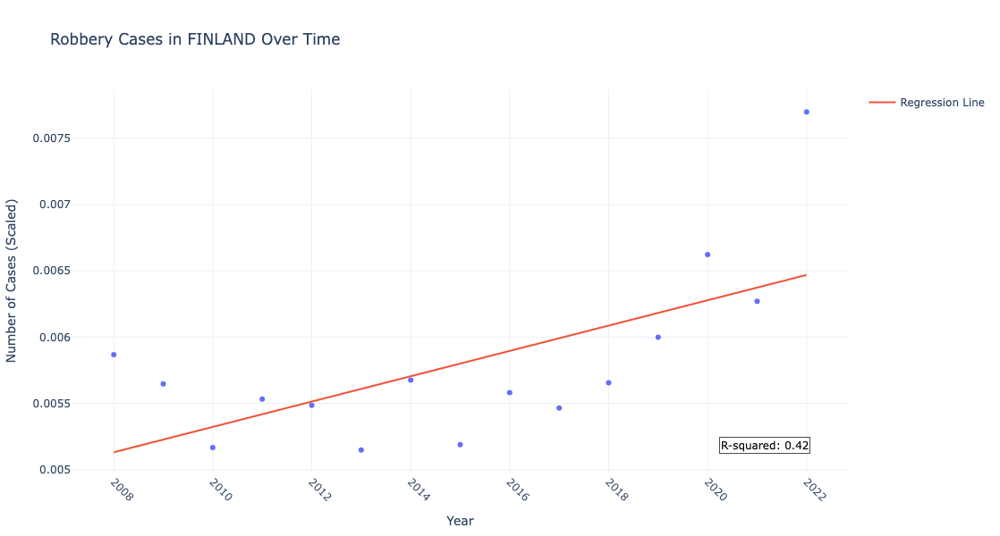

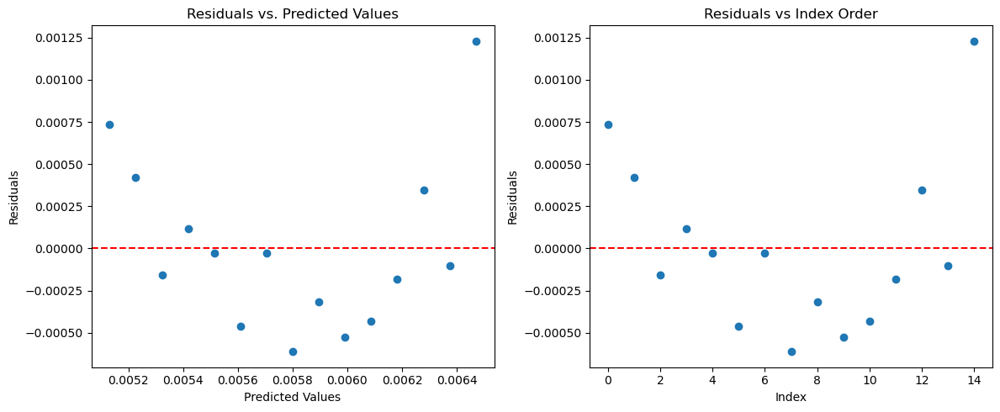

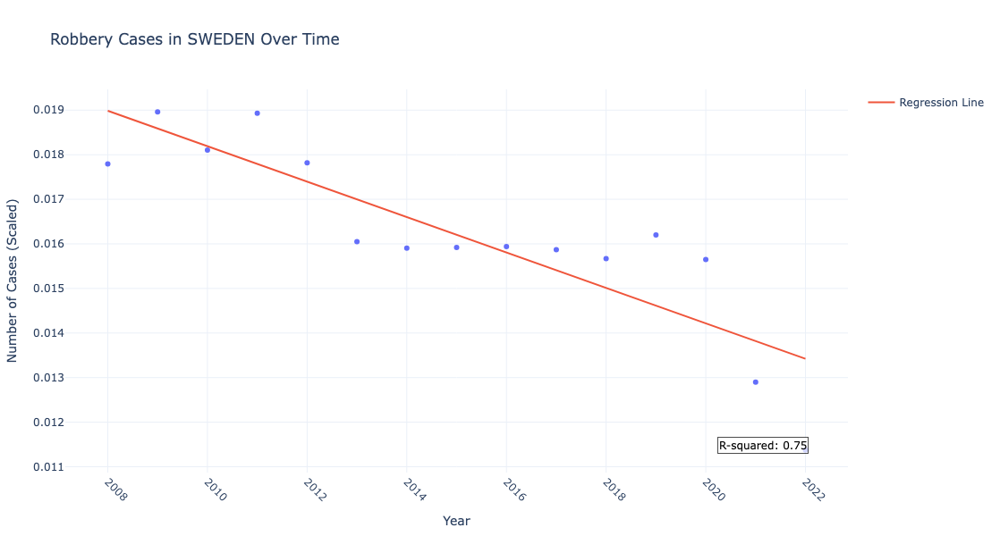

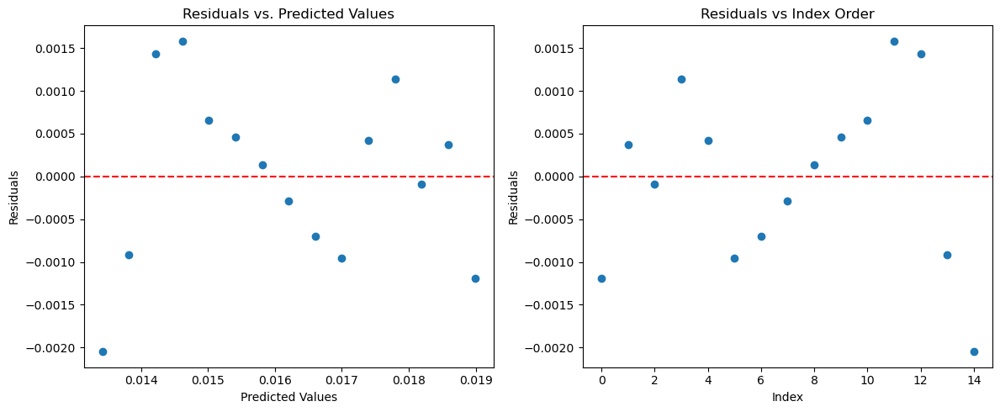

In [47]:
import numpy as np
import pandas as pd
import plotly.express as px
import plotly.graph_objects as go
import matplotlib.pyplot as plt

robbery_data = crime[crime['International classification of crime for statistical purposes (ICCS)'] == 'Robbery']

# Define the linear regression function
def linear_regression(x, y):
    n = len(x)
    sum_x = np.sum(x)
    sum_y = np.sum(y)
    sum_xy = np.sum(x * y)
    sum_x_squared = np.sum(x ** 2)
    
    m = (n * sum_xy - sum_x * sum_y) / (n * sum_x_squared - sum_x ** 2)
    b = (sum_y - m * sum_x) / n
    
    return m, b

# Add function to predict y values
def linreg_predict(X, y, coefficients):
    m, b = coefficients
    ypreds = m * X + b
    resids = y - ypreds
    return {'ypreds': ypreds, 'resids': resids}

# Function to plot residuals and predictions
def plot_residuals_predictions(ypreds, resids):
    plt.figure(figsize=(12, 5))

    plt.subplot(1, 2, 1)
    plt.scatter(ypreds, resids)
    plt.axhline(0, color='red', linestyle='--')
    plt.xlabel('Predicted Values')
    plt.ylabel('Residuals')
    plt.title('Residuals vs. Predicted Values')

    plt.subplot(1, 2, 2)
    plt.plot(resids, marker='o', linestyle='none')
    plt.axhline(0, color='red', linestyle='--')
    plt.xlabel('Index')
    plt.ylabel('Residuals')
    plt.title('Residuals vs Index Order')

    plt.tight_layout()
    plt.show()

# Loop over countries and perform linear regression
countries = robbery_data['Geopolitical entity (reporting)'].unique()
for country in countries:
    country_data = robbery_data[robbery_data['Geopolitical entity (reporting)'] == country]
    
    x = country_data['Time'].values
    y = country_data['norm_val'].values
    
    # Perform linear regression
    coefficients = linear_regression(x, y)
    
    # Calculate R-squared value
    ypreds = linreg_predict(x, y, coefficients)['ypreds']
    ss_res = np.sum((y - ypreds) ** 2)
    ss_tot = np.sum((y - np.mean(y)) ** 2)
    r_squared = 1 - (ss_res / ss_tot)
    
    # Plot regression line using Plotly
    m, b = coefficients
    regression_line = m * x + b
    
    fig = px.scatter(country_data, x='Time', y='norm_val', title=f'Robbery Cases in {country} Over Time')
    
    fig.add_traces(go.Scatter(x=x, y=regression_line, mode='lines', name='Regression Line'))
    
    fig.update_layout(
        xaxis_title='Year',
        yaxis_title='Number of Cases (Scaled)',
        template='plotly_white',
        width=900,
        height=600,
        margin=dict(l=50, r=50, t=100, b=50)
    )
    
    fig.update_xaxes(tickangle=45)
    
    # Add R-squared value as text annotation
    fig.add_annotation(
        xref='paper', yref='paper',
        x=0.95, y=0.05,
        text=f'R-squared: {r_squared:.2f}',
        showarrow=False,
        font=dict(size=12, color='black'),
        bgcolor='rgba(255, 255, 255, 0.7)',
        bordercolor='rgba(0, 0, 0, 0.7)',
        borderwidth=1
    )
    
    fig.show()
    
    # Plot residuals and predictions for diagnostic checks
    plot_residuals_predictions(ypreds, y - ypreds)


Shown above are linear regression plots using robbery data per nation in the EU over time. Additionally, below each national plot, analysis plots of the residuals are shown. These are done to verify the assumptions made when fitting a linear model. While some models fit extremely poorly (such as Luxembourg with an r2 of only 0.01), the majority exhibit high goodness of fits. This is further supported with the residuals analysis, which show a net zero error placed across a seemily random pattern. Most Residuals vs. Predicted Values plots have no clear pattern, supporting the assumption of constant variance. This is also the case with the Residuals vs. Index plots, suggesting a lack of autocorrelation in the majority of cases.

In [48]:
merged_df = pd.merge(train_system_ohe, crime_ohe, how='inner')
merged_df

,Time frequency,Unit of measure,Transport coverage,Time,value,Geopolitical entity (reporting)_AUSTRIA,Geopolitical entity (reporting)_BELGIUM,Geopolitical entity (reporting)_BULGARIA,Geopolitical entity (reporting)_CROATIA,Geopolitical entity (reporting)_CYPRUS,...,International classification of crime for statistical purposes (ICCS)_Participation in an organized criminal group,International classification of crime for statistical purposes (ICCS)_Rape,International classification of crime for statistical purposes (ICCS)_Robbery,International classification of crime for statistical purposes (ICCS)_Serious assault,International classification of crime for statistical purposes (ICCS)_Sexual assault,International classification of crime for statistical purposes (ICCS)_Sexual exploitation,International classification of crime for statistical purposes (ICCS)_Sexual violence,International classification of crime for statistical purposes (ICCS)_Theft,International classification of crime for statistical purposes (ICCS)_Theft of a motorized vehicle or parts thereof,International classification of crime for statistical purposes (ICCS)_Unlawful acts involving controlled drugs or precursors


In [49]:
crime_ohe.columns

Index(['Time frequency', 'Unit of measure', 'Time', 'value',
       'International classification of crime for statistical purposes (ICCS)_Acts against computer systems',
       'International classification of crime for statistical purposes (ICCS)_Attempted intentional homicide',
       'International classification of crime for statistical purposes (ICCS)_Bribery',
       'International classification of crime for statistical purposes (ICCS)_Burglary',
       'International classification of crime for statistical purposes (ICCS)_Burglary of private residential premises',
       'International classification of crime for statistical purposes (ICCS)_Child pornography',
       'International classification of crime for statistical purposes (ICCS)_Corruption',
       'International classification of crime for statistical purposes (ICCS)_Fraud',
       'International classification of crime for statistical purposes (ICCS)_Intentional homicide',
       'International classification of crim

In [50]:
train_system_ohe.columns

Index(['Time frequency', 'Unit of measure', 'Transport coverage', 'Time',
       'value', 'Geopolitical entity (reporting)_AUSTRIA',
       'Geopolitical entity (reporting)_BELGIUM',
       'Geopolitical entity (reporting)_BULGARIA',
       'Geopolitical entity (reporting)_CROATIA',
       'Geopolitical entity (reporting)_CYPRUS',
       'Geopolitical entity (reporting)_CZECHIA',
       'Geopolitical entity (reporting)_DENMARK',
       'Geopolitical entity (reporting)_ESTONIA',
       'Geopolitical entity (reporting)_FINLAND',
       'Geopolitical entity (reporting)_FRANCE',
       'Geopolitical entity (reporting)_GERMANY',
       'Geopolitical entity (reporting)_GREECE',
       'Geopolitical entity (reporting)_HUNGARY',
       'Geopolitical entity (reporting)_IRELAND',
       'Geopolitical entity (reporting)_ITALY',
       'Geopolitical entity (reporting)_LATVIA',
       'Geopolitical entity (reporting)_LITHUANIA',
       'Geopolitical entity (reporting)_LUXEMBOURG',
       'Geopoliti

In [51]:
max_year = happiness['Time'].max()
happiness = happiness.drop(happiness[happiness.Time != max_year].index)
happiness_my = happiness[happiness['International Standard Classification of Education (ISCED 2011)'] == 'All ISCED 2011 levels']

happiness_my

,Time frequency,Unit of measure,International Standard Classification of Education (ISCED 2011),Frequency,Sex,Age class,Geopolitical entity (reporting),Time,value
5,Annual,Percentage,All ISCED 2011 levels,Always,Total,From 16 to 24 years,BELGIUM,2022,19.6
8,Annual,Percentage,All ISCED 2011 levels,Always,Total,From 16 to 24 years,BULGARIA,2022,14.9
11,Annual,Percentage,All ISCED 2011 levels,Always,Total,From 16 to 24 years,CZECHIA,2022,8.6
14,Annual,Percentage,All ISCED 2011 levels,Always,Total,From 16 to 24 years,DENMARK,2022,8.5
20,Annual,Percentage,All ISCED 2011 levels,Always,Total,From 16 to 24 years,ESTONIA,2022,6.1
...,...,...,...,...,...,...,...,...,...
11927,Annual,Percentage,All ISCED 2011 levels,Never,Females,75 years or over,ROMANIA,2022,6.1
11930,Annual,Percentage,All ISCED 2011 levels,Never,Females,75 years or over,SLOVENIA,2022,3.2
11933,Annual,Percentage,All ISCED 2011 levels,Never,Females,75 years or over,SLOVAKIA,2022,2.1
11936,Annual,Percentage,All ISCED 2011 levels,Never,Females,75 years or over,FINLAND,2022,2.0


In [52]:
import pandas as pd

# Initialize the dictionary with age groups as keys
happiness_dict = {
    "country": [],
    'From 16 to 24 years': [], '16 years or over': [], 'From 25 to 34 years': [],
    'From 35 to 49 years': [], 'From 50 to 64 years': [], 'From 65 to 74 years': [],
    '75 years or over': []
}


# Process each country
for country in eu_nations:
    happiness_dict["country"].append(country)
    
    # Filter dataset for the current country
    df_country = happiness_my[happiness_my["Geopolitical entity (reporting)"] == country]
    
    # Process each age group
    for age_group in ['From 16 to 24 years', '16 years or over', 'From 25 to 34 years', 'From 35 to 49 years', 'From 50 to 64 years', 'From 65 to 74 years', '75 years or over']:
        # Filter for relevant age group
        df_age_group = df_country[df_country["Age class"] == age_group]
        
        # Sum the values
        age_group_sum = df_age_group["value"].sum()
        
        # Append the sum to the respective age group in the dictionary
        happiness_dict[age_group].append(age_group_sum)

# Convert to DataFrame
happiness_df = pd.DataFrame(happiness_dict)

happiness_df

,country,From 16 to 24 years,16 years or over,From 25 to 34 years,From 35 to 49 years,From 50 to 64 years,From 65 to 74 years,75 years or over
0,AUSTRIA,299.9,300.0,299.9,299.9,299.9,300.0,299.9
1,BELGIUM,297.2,299.4,300.0,299.8,299.7,299.5,298.8
2,BULGARIA,282.7,277.0,282.6,282.9,276.6,270.7,267.7
3,CROATIA,297.4,291.0,287.4,293.7,290.2,293.4,287.7
4,CYPRUS,298.0,298.4,298.4,299.1,299.0,299.1,294.3
5,CZECHIA,286.9,283.8,285.4,288.1,281.6,283.2,277.1
6,DENMARK,292.1,295.9,298.6,295.5,297.9,295.2,291.6
7,ESTONIA,300.0,299.9,300.0,299.9,300.1,300.1,300.0
8,FINLAND,299.7,298.7,300.2,299.5,299.2,297.1,294.8
9,FRANCE,299.4,298.6,299.7,299.4,298.5,297.7,296.9


In [53]:
crime_my = crime[crime['Time'] == max_year]
crime_my

,Time frequency,International classification of crime for statistical purposes (ICCS),Unit of measure,Geopolitical entity (reporting),Time,value,norm_val
629,Annual,Intentional homicide,Per hundred thousand inhabitants,BELGIUM,2022,1.54,0.000282
644,Annual,Intentional homicide,Per hundred thousand inhabitants,BULGARIA,2022,1.11,0.000204
659,Annual,Intentional homicide,Per hundred thousand inhabitants,CZECHIA,2022,0.75,0.000138
674,Annual,Intentional homicide,Per hundred thousand inhabitants,DENMARK,2022,1.00,0.000183
689,Annual,Intentional homicide,Per hundred thousand inhabitants,GERMANY,2022,0.74,0.000136
...,...,...,...,...,...,...,...
25544,Annual,Participation in an organized criminal group,Per hundred thousand inhabitants,PORTUGAL,2022,0.06,0.000011
25559,Annual,Participation in an organized criminal group,Per hundred thousand inhabitants,ROMANIA,2022,2.71,0.000497
25574,Annual,Participation in an organized criminal group,Per hundred thousand inhabitants,SLOVENIA,2022,0.00,0.000000
25589,Annual,Participation in an organized criminal group,Per hundred thousand inhabitants,SLOVAKIA,2022,0.15,0.000028


In [54]:
train_system

,Time frequency,Unit of measure,Transport coverage,Geopolitical entity (reporting),Time,value
36,Annual,Millions of passenger-kilometres,Total transport,BELGIUM,2012,NaN
37,Annual,Millions of passenger-kilometres,Total transport,BELGIUM,2013,NaN
38,Annual,Millions of passenger-kilometres,Total transport,BELGIUM,2014,NaN
39,Annual,Millions of passenger-kilometres,Total transport,BELGIUM,2015,NaN
40,Annual,Millions of passenger-kilometres,Total transport,BELGIUM,2016,NaN
...,...,...,...,...,...,...
355,Annual,Millions of passenger-kilometres,Total transport,SWEDEN,2019,14617.0
356,Annual,Millions of passenger-kilometres,Total transport,SWEDEN,2020,8129.0
357,Annual,Millions of passenger-kilometres,Total transport,SWEDEN,2021,8027.0
358,Annual,Millions of passenger-kilometres,Total transport,SWEDEN,2022,12879.0


In [55]:
train_system_my = train_system[train_system['Time'] == max_year]
train_system_my

,Time frequency,Unit of measure,Transport coverage,Geopolitical entity (reporting),Time,value
46,Annual,Millions of passenger-kilometres,Total transport,BELGIUM,2022,NaN
58,Annual,Millions of passenger-kilometres,Total transport,BULGARIA,2022,1600.0
70,Annual,Millions of passenger-kilometres,Total transport,CZECHIA,2022,9394.0
82,Annual,Millions of passenger-kilometres,Total transport,DENMARK,2022,6376.0
94,Annual,Millions of passenger-kilometres,Total transport,GERMANY,2022,92313.0
106,Annual,Millions of passenger-kilometres,Total transport,ESTONIA,2022,382.0
118,Annual,Millions of passenger-kilometres,Total transport,IRELAND,2022,1748.0
130,Annual,Millions of passenger-kilometres,Total transport,GREECE,2022,1117.0
142,Annual,Millions of passenger-kilometres,Total transport,SPAIN,2022,27489.0
154,Annual,Millions of passenger-kilometres,Total transport,FRANCE,2022,102814.0


In [56]:
train_system_my 

,Time frequency,Unit of measure,Transport coverage,Geopolitical entity (reporting),Time,value
46,Annual,Millions of passenger-kilometres,Total transport,BELGIUM,2022,NaN
58,Annual,Millions of passenger-kilometres,Total transport,BULGARIA,2022,1600.0
70,Annual,Millions of passenger-kilometres,Total transport,CZECHIA,2022,9394.0
82,Annual,Millions of passenger-kilometres,Total transport,DENMARK,2022,6376.0
94,Annual,Millions of passenger-kilometres,Total transport,GERMANY,2022,92313.0
106,Annual,Millions of passenger-kilometres,Total transport,ESTONIA,2022,382.0
118,Annual,Millions of passenger-kilometres,Total transport,IRELAND,2022,1748.0
130,Annual,Millions of passenger-kilometres,Total transport,GREECE,2022,1117.0
142,Annual,Millions of passenger-kilometres,Total transport,SPAIN,2022,27489.0
154,Annual,Millions of passenger-kilometres,Total transport,FRANCE,2022,102814.0


In [57]:
crime_my_ohe_cols = ['International classification of crime for statistical purposes (ICCS)', 'Geopolitical entity (reporting)']
crime_my_ohe = pd.get_dummies(crime_my, columns=crime_ohe_cols, dtype=int)
crime_my_ohe

,Time frequency,Unit of measure,Time,value,norm_val,International classification of crime for statistical purposes (ICCS)_Acts against computer systems,International classification of crime for statistical purposes (ICCS)_Attempted intentional homicide,International classification of crime for statistical purposes (ICCS)_Bribery,International classification of crime for statistical purposes (ICCS)_Burglary,International classification of crime for statistical purposes (ICCS)_Burglary of private residential premises,...,Geopolitical entity (reporting)_LUXEMBOURG,Geopolitical entity (reporting)_MALTA,Geopolitical entity (reporting)_NETHERLANDS,Geopolitical entity (reporting)_POLAND,Geopolitical entity (reporting)_PORTUGAL,Geopolitical entity (reporting)_ROMANIA,Geopolitical entity (reporting)_SLOVAKIA,Geopolitical entity (reporting)_SLOVENIA,Geopolitical entity (reporting)_SPAIN,Geopolitical entity (reporting)_SWEDEN
629,Annual,Per hundred thousand inhabitants,2022,1.54,0.000282,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
644,Annual,Per hundred thousand inhabitants,2022,1.11,0.000204,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
659,Annual,Per hundred thousand inhabitants,2022,0.75,0.000138,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
674,Annual,Per hundred thousand inhabitants,2022,1.00,0.000183,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
689,Annual,Per hundred thousand inhabitants,2022,0.74,0.000136,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
25544,Annual,Per hundred thousand inhabitants,2022,0.06,0.000011,0,0,0,0,0,...,0,0,0,0,1,0,0,0,0,0
25559,Annual,Per hundred thousand inhabitants,2022,2.71,0.000497,0,0,0,0,0,...,0,0,0,0,0,1,0,0,0,0
25574,Annual,Per hundred thousand inhabitants,2022,0.00,0.000000,0,0,0,0,0,...,0,0,0,0,0,0,0,1,0,0
25589,Annual,Per hundred thousand inhabitants,2022,0.15,0.000028,0,0,0,0,0,...,0,0,0,0,0,0,1,0,0,0


In [58]:
happiness_my_ohe_cols = ['International Standard Classification of Education (ISCED 2011)', 'Frequency', 'Sex', 'Age class', 'Geopolitical entity (reporting)']
happiness_my_ohe = pd.get_dummies(happiness_my, columns=happiness_ohe_cols, dtype=int)
happiness_my_ohe

,Time frequency,Unit of measure,Time,value,International Standard Classification of Education (ISCED 2011)_All ISCED 2011 levels,Frequency_Always,Frequency_Most of the time,Frequency_Never,Frequency_Rarely,Frequency_Sometimes,...,Geopolitical entity (reporting)_LUXEMBOURG,Geopolitical entity (reporting)_MALTA,Geopolitical entity (reporting)_NETHERLANDS,Geopolitical entity (reporting)_POLAND,Geopolitical entity (reporting)_PORTUGAL,Geopolitical entity (reporting)_ROMANIA,Geopolitical entity (reporting)_SLOVAKIA,Geopolitical entity (reporting)_SLOVENIA,Geopolitical entity (reporting)_SPAIN,Geopolitical entity (reporting)_SWEDEN
5,Annual,Percentage,2022,19.6,1,1,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
8,Annual,Percentage,2022,14.9,1,1,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
11,Annual,Percentage,2022,8.6,1,1,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
14,Annual,Percentage,2022,8.5,1,1,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
20,Annual,Percentage,2022,6.1,1,1,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
11927,Annual,Percentage,2022,6.1,1,0,0,1,0,0,...,0,0,0,0,0,1,0,0,0,0
11930,Annual,Percentage,2022,3.2,1,0,0,1,0,0,...,0,0,0,0,0,0,0,1,0,0
11933,Annual,Percentage,2022,2.1,1,0,0,1,0,0,...,0,0,0,0,0,0,1,0,0,0
11936,Annual,Percentage,2022,2.0,1,0,0,1,0,0,...,0,0,0,0,0,0,0,0,0,0


In [59]:
trains_my_ohe_cols = ['Geopolitical entity (reporting)']
train_system_my_ohe = pd.get_dummies(train_system_my, columns=trains_ohe_cols, dtype=int)
train_system_my_ohe

,Time frequency,Unit of measure,Transport coverage,Time,value,Geopolitical entity (reporting)_AUSTRIA,Geopolitical entity (reporting)_BELGIUM,Geopolitical entity (reporting)_BULGARIA,Geopolitical entity (reporting)_CROATIA,Geopolitical entity (reporting)_CYPRUS,...,Geopolitical entity (reporting)_LUXEMBOURG,Geopolitical entity (reporting)_MALTA,Geopolitical entity (reporting)_NETHERLANDS,Geopolitical entity (reporting)_POLAND,Geopolitical entity (reporting)_PORTUGAL,Geopolitical entity (reporting)_ROMANIA,Geopolitical entity (reporting)_SLOVAKIA,Geopolitical entity (reporting)_SLOVENIA,Geopolitical entity (reporting)_SPAIN,Geopolitical entity (reporting)_SWEDEN
46,Annual,Millions of passenger-kilometres,Total transport,2022,NaN,0,1,0,0,0,...,0,0,0,0,0,0,0,0,0,0
58,Annual,Millions of passenger-kilometres,Total transport,2022,1600.0,0,0,1,0,0,...,0,0,0,0,0,0,0,0,0,0
70,Annual,Millions of passenger-kilometres,Total transport,2022,9394.0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
82,Annual,Millions of passenger-kilometres,Total transport,2022,6376.0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
94,Annual,Millions of passenger-kilometres,Total transport,2022,92313.0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
106,Annual,Millions of passenger-kilometres,Total transport,2022,382.0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
118,Annual,Millions of passenger-kilometres,Total transport,2022,1748.0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
130,Annual,Millions of passenger-kilometres,Total transport,2022,1117.0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
142,Annual,Millions of passenger-kilometres,Total transport,2022,27489.0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,1,0
154,Annual,Millions of passenger-kilometres,Total transport,2022,102814.0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [60]:
crime_my

,Time frequency,International classification of crime for statistical purposes (ICCS),Unit of measure,Geopolitical entity (reporting),Time,value,norm_val
629,Annual,Intentional homicide,Per hundred thousand inhabitants,BELGIUM,2022,1.54,0.000282
644,Annual,Intentional homicide,Per hundred thousand inhabitants,BULGARIA,2022,1.11,0.000204
659,Annual,Intentional homicide,Per hundred thousand inhabitants,CZECHIA,2022,0.75,0.000138
674,Annual,Intentional homicide,Per hundred thousand inhabitants,DENMARK,2022,1.00,0.000183
689,Annual,Intentional homicide,Per hundred thousand inhabitants,GERMANY,2022,0.74,0.000136
...,...,...,...,...,...,...,...
25544,Annual,Participation in an organized criminal group,Per hundred thousand inhabitants,PORTUGAL,2022,0.06,0.000011
25559,Annual,Participation in an organized criminal group,Per hundred thousand inhabitants,ROMANIA,2022,2.71,0.000497
25574,Annual,Participation in an organized criminal group,Per hundred thousand inhabitants,SLOVENIA,2022,0.00,0.000000
25589,Annual,Participation in an organized criminal group,Per hundred thousand inhabitants,SLOVAKIA,2022,0.15,0.000028


In [61]:
education = get_eurostat_data('educ_uoe_fine02')

In [62]:
education['Geopolitical entity (reporting)'] = education['Geopolitical entity (reporting)'].str.upper()
education = education[education['Geopolitical entity (reporting)'].isin(eu_nations)]
education['Time'] = education["Time"].astype(int)
education.dtypes

Time frequency                                                      object
Unit of measure                                                     object
Sector                                                              object
Counterpart sector                                                  object
Expenditure and investment                                          object
International Standard Classification of Education (ISCED 2011)     object
Geopolitical entity (reporting)                                     object
Time                                                                 int64
value                                                              float64
dtype: object

In [63]:
education = education[education['Expenditure and investment'] == 'Total']
education = education[education['Time'] == 2020]
education = education[education['Counterpart sector'] == 'Total economy']
education = education[education['Sector'] == 'General government']
education = education[education['Unit of measure'] == 'Million euro']
education['International Standard Classification of Education (ISCED 2011)'].unique()

array(['Early childhood education',
       'Early childhood educational development',
       'Pre-primary to tertiary education', 'Pre-primary education',
       'Primary and lower secondary education (levels 1 and 2)',
       'Primary education', 'Lower secondary education',
       'Lower secondary education - general',
       'Lower secondary education - vocational',
       'Upper secondary and post-secondary non-tertiary education (levels 3 and 4)',
       'Upper secondary education',
       'Upper secondary and post-secondary non-tertiary education - general (levels 34 and 44)',
       'Upper secondary education - general',
       'Upper secondary and post-secondary non-tertiary education - vocational (levels 35 and 45)',
       'Upper secondary education - vocational',
       'Post-secondary non-tertiary education',
       'Post-secondary non-tertiary education - general',
       'Post-secondary non-tertiary education - vocational',
       'Tertiary education (levels 5-8)',
      

In [64]:
education

,Time frequency,Unit of measure,Sector,Counterpart sector,Expenditure and investment,International Standard Classification of Education (ISCED 2011),Geopolitical entity (reporting),Time,value
26,Annual,Million euro,General government,Total economy,Total,Early childhood education,BELGIUM,2020,NaN
35,Annual,Million euro,General government,Total economy,Total,Early childhood education,BULGARIA,2020,598.9
44,Annual,Million euro,General government,Total economy,Total,Early childhood education,CZECHIA,2020,1341.1
53,Annual,Million euro,General government,Total economy,Total,Early childhood education,DENMARK,2020,3126.8
62,Annual,Million euro,General government,Total economy,Total,Early childhood education,GERMANY,2020,34618.6
...,...,...,...,...,...,...,...,...,...
6884,Annual,Million euro,General government,Total economy,Total,Tertiary education excluding short-cycle terti...,ROMANIA,2020,1778.8
6893,Annual,Million euro,General government,Total economy,Total,Tertiary education excluding short-cycle terti...,SLOVENIA,2020,516.8
6902,Annual,Million euro,General government,Total economy,Total,Tertiary education excluding short-cycle terti...,SLOVAKIA,2020,834.6
6911,Annual,Million euro,General government,Total economy,Total,Tertiary education excluding short-cycle terti...,FINLAND,2020,3776.9


In [65]:
education[education['Geopolitical entity (reporting)'] == 'BELGIUM']

,Time frequency,Unit of measure,Sector,Counterpart sector,Expenditure and investment,International Standard Classification of Education (ISCED 2011),Geopolitical entity (reporting),Time,value
26,Annual,Million euro,General government,Total economy,Total,Early childhood education,BELGIUM,2020,NaN
359,Annual,Million euro,General government,Total economy,Total,Early childhood educational development,BELGIUM,2020,NaN
692,Annual,Million euro,General government,Total economy,Total,Pre-primary to tertiary education,BELGIUM,2020,30865.9
1025,Annual,Million euro,General government,Total economy,Total,Pre-primary education,BELGIUM,2020,3332.1
1358,Annual,Million euro,General government,Total economy,Total,Primary and lower secondary education (levels ...,BELGIUM,2020,11823.7
1691,Annual,Million euro,General government,Total economy,Total,Primary education,BELGIUM,2020,7426.7
2024,Annual,Million euro,General government,Total economy,Total,Lower secondary education,BELGIUM,2020,4397.0
2357,Annual,Million euro,General government,Total economy,Total,Lower secondary education - general,BELGIUM,2020,NaN
2690,Annual,Million euro,General government,Total economy,Total,Lower secondary education - vocational,BELGIUM,2020,NaN
3023,Annual,Million euro,General government,Total economy,Total,Upper secondary and post-secondary non-tertiar...,BELGIUM,2020,8274.8


In [66]:
education['International Standard Classification of Education (ISCED 2011)'].unique()

array(['Early childhood education',
       'Early childhood educational development',
       'Pre-primary to tertiary education', 'Pre-primary education',
       'Primary and lower secondary education (levels 1 and 2)',
       'Primary education', 'Lower secondary education',
       'Lower secondary education - general',
       'Lower secondary education - vocational',
       'Upper secondary and post-secondary non-tertiary education (levels 3 and 4)',
       'Upper secondary education',
       'Upper secondary and post-secondary non-tertiary education - general (levels 34 and 44)',
       'Upper secondary education - general',
       'Upper secondary and post-secondary non-tertiary education - vocational (levels 35 and 45)',
       'Upper secondary education - vocational',
       'Post-secondary non-tertiary education',
       'Post-secondary non-tertiary education - general',
       'Post-secondary non-tertiary education - vocational',
       'Tertiary education (levels 5-8)',
      

In [67]:
education = education.groupby('Geopolitical entity (reporting)')['value'].sum().reset_index()

In [68]:
education

,Geopolitical entity (reporting),value
0,AUSTRIA,74627.4
1,BELGIUM,105815.4
2,BULGARIA,9457.8
3,CROATIA,5581.2
4,CYPRUS,4538.5
5,CZECHIA,37095.7
6,DENMARK,77810.0
7,ESTONIA,3286.7
8,FINLAND,55496.7
9,FRANCE,476838.3


In [69]:
average_value = education.loc[education['value'] != 0, 'value'].mean()
education['value'] = education['value'].replace(0, average_value)

education

,Geopolitical entity (reporting),value
0,AUSTRIA,74627.400000
1,BELGIUM,105815.400000
2,BULGARIA,9457.800000
3,CROATIA,5581.200000
4,CYPRUS,4538.500000
5,CZECHIA,37095.700000
6,DENMARK,77810.000000
7,ESTONIA,3286.700000
8,FINLAND,55496.700000
9,FRANCE,476838.300000


### Initialization of a Model

In [70]:
cost_of_living_my = cost_of_living[cost_of_living['Time'] == 2022]

In [71]:
max_year_cof = cost_of_living['Time'].max()
df_2022 = cost_of_living[cost_of_living['Time'] == '2021']



In [81]:
cof_filtered = df_2022[['Geopolitical entity (reporting)', 'value']]
cof_filtered = cof_filtered.dropna()
cof_filtered = cof_filtered.groupby('Geopolitical entity (reporting)').mean().reset_index()
print(cof_filtered)

             Geopolitical entity (reporting)      value
0  European Union - 27 countries (from 2020)  33.330719


In [73]:
max_year_cof

'2023'

In [82]:
social_exclusion

,Time frequency,Unit of measure,Age class,Sex,Geopolitical entity (reporting),Time,value
0,Annual,Thousand persons,Total,Total,"European Union (EU6-1958, EU9-1973, EU10-1981,...",2014,NaN
1,Annual,Thousand persons,Total,Total,"European Union (EU6-1958, EU9-1973, EU10-1981,...",2015,119632.0
2,Annual,Thousand persons,Total,Total,"European Union (EU6-1958, EU9-1973, EU10-1981,...",2016,117794.0
3,Annual,Thousand persons,Total,Total,"European Union (EU6-1958, EU9-1973, EU10-1981,...",2017,112399.0
4,Annual,Thousand persons,Total,Total,"European Union (EU6-1958, EU9-1973, EU10-1981,...",2018,109997.0
...,...,...,...,...,...,...,...
89755,Annual,Percentage,75 years or over,Females,Türkiye,2019,26.2
89756,Annual,Percentage,75 years or over,Females,Türkiye,2020,25.8
89757,Annual,Percentage,75 years or over,Females,Türkiye,2021,20.3
89758,Annual,Percentage,75 years or over,Females,Türkiye,2022,NaN


In [83]:
social_exclusion = social_exclusion[social_exclusion['Time'] == '2022']
social_exclusion

,Time frequency,Unit of measure,Age class,Sex,Geopolitical entity (reporting),Time,value
8,Annual,Thousand persons,Total,Total,"European Union (EU6-1958, EU9-1973, EU10-1981,...",2022,NaN
18,Annual,Thousand persons,Total,Total,European Union - 27 countries (from 2020),2022,95324.0
28,Annual,Thousand persons,Total,Total,European Union - 28 countries (2013-2020),2022,NaN
38,Annual,Thousand persons,Total,Total,European Union - 27 countries (2007-2013),2022,NaN
48,Annual,Thousand persons,Total,Total,"Euro area (EA11-1999, EA12-2001, EA13-2007, EA...",2022,NaN
...,...,...,...,...,...,...,...
89718,Annual,Percentage,75 years or over,Females,Montenegro,2022,27.7
89728,Annual,Percentage,75 years or over,Females,North Macedonia,2022,NaN
89738,Annual,Percentage,75 years or over,Females,Albania,2022,NaN
89748,Annual,Percentage,75 years or over,Females,Serbia,2022,41.9


In [86]:
social_exclusion = social_exclusion.dropna()
social_exclusion = social

,Time frequency,Unit of measure,Age class,Sex,Geopolitical entity (reporting),Time,value
18,Annual,Thousand persons,Total,Total,European Union - 27 countries (from 2020),2022,95324.0
58,Annual,Thousand persons,Total,Total,Euro area – 20 countries (from 2023),2022,74823.0
88,Annual,Thousand persons,Total,Total,Belgium,2022,2144.0
98,Annual,Thousand persons,Total,Total,Bulgaria,2022,2206.0
108,Annual,Thousand persons,Total,Total,Czechia,2022,1209.0
...,...,...,...,...,...,...,...
89668,Annual,Percentage,75 years or over,Females,Sweden,2022,22.2
89688,Annual,Percentage,75 years or over,Females,Norway,2022,14.8
89698,Annual,Percentage,75 years or over,Females,Switzerland,2022,33.7
89718,Annual,Percentage,75 years or over,Females,Montenegro,2022,27.7
